Picutures are taken from here

https://github.com/Dyakonov/DL/blob/master/2022/DL_3NLP_02texts_202203a.pdf

https://github.com/Dyakonov/DL/blob/master/2022/DL_3NLP_04transformer_202204a.pdf

https://github.com/Dyakonov/DL/blob/master/2022/DL_3NLP_06languagemodel_202204a.pdf

# seq2seq


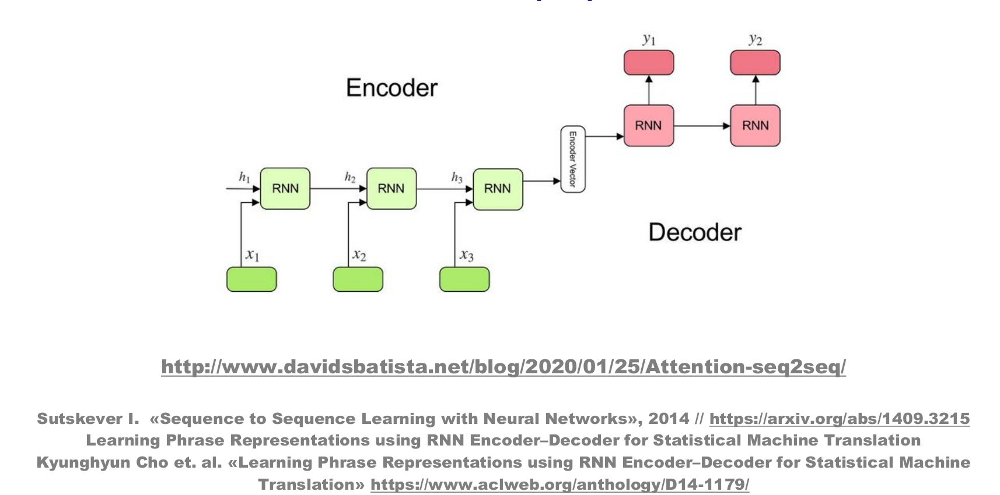

- mutlilayer LSTM
- encoder - decoder architechture
- encoder: input -> vector
- decoder: vector -> target
- both encoder and decoder are LSTM with different parameters
- inverting of input order increases translation quality
- ensembles are good too

### Inner representation of sentences (for seq2seq)

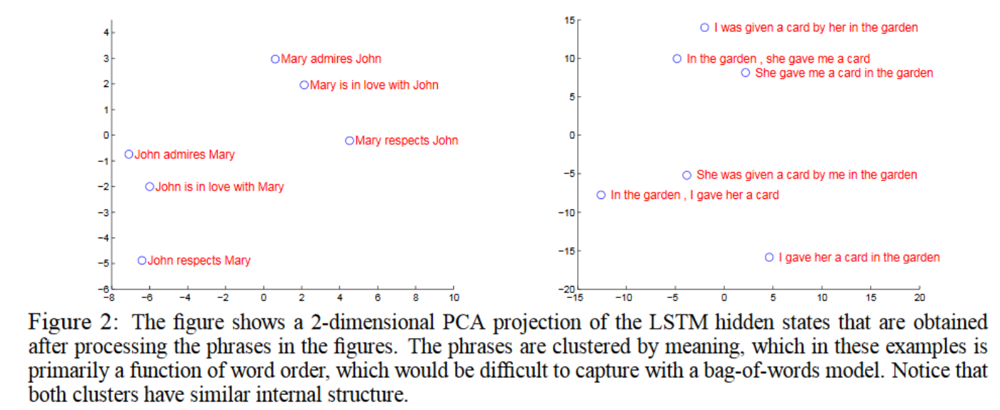

# Attention

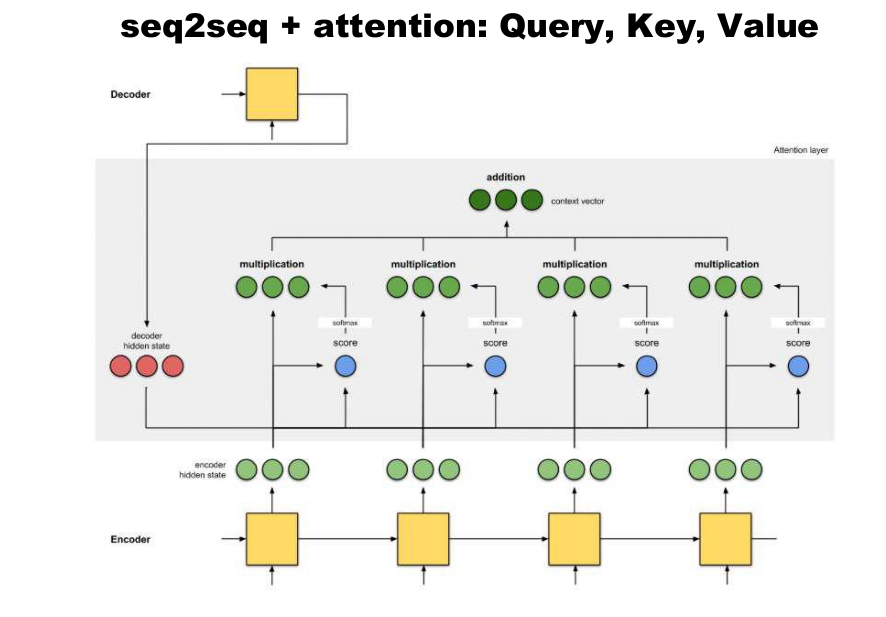

Mechanism that lets decoder to "look" at previous/next encoder states to make more precise decision

### Key-Query-Value paradigm

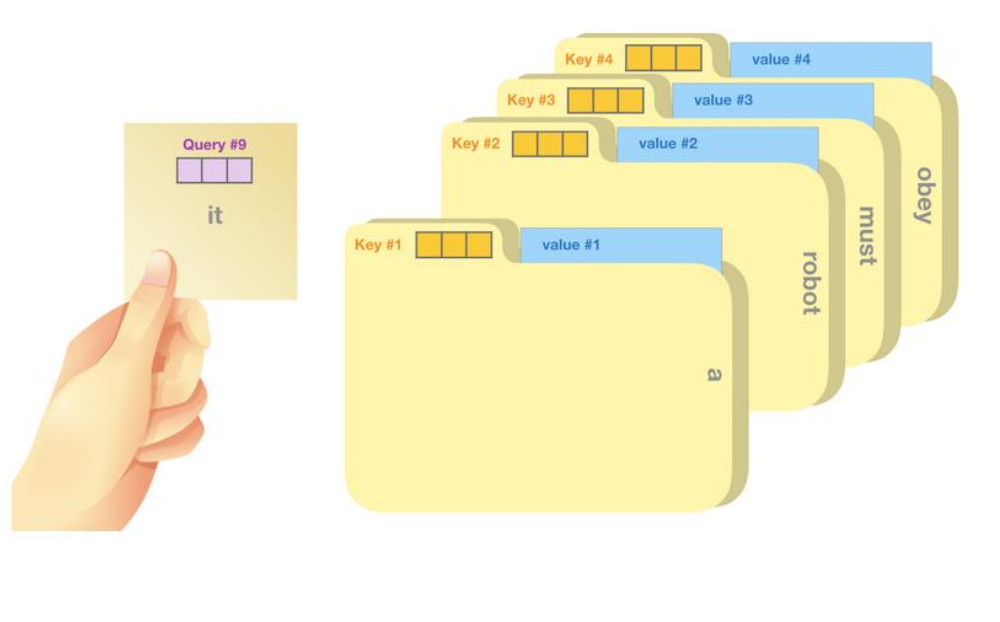

### Attention mechanism

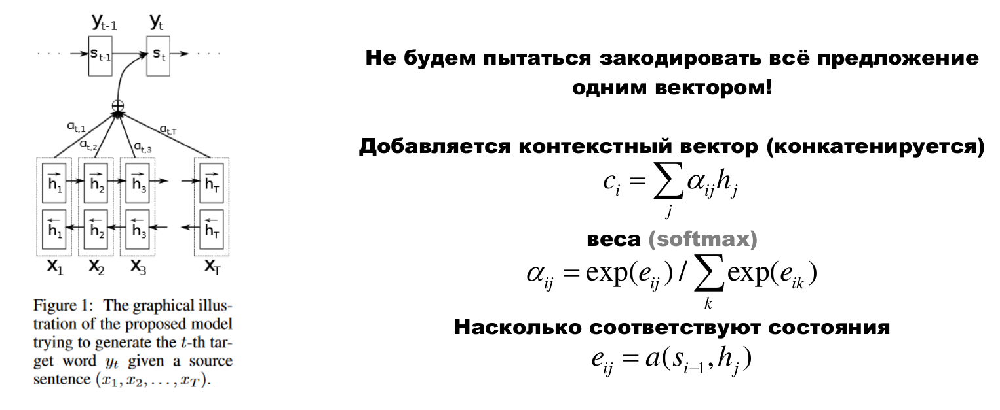



x<sub>1</sub>, x<sub>2</sub>, ..., x<sub>t</sub> - input sentense tokens 

h<sub>1</sub>, h<sub>2</sub>, ..., h<sub>t</sub> - encoder hidden states (**key**)

y<sub>1</sub>, y<sub>2</sub>, ..., x<sub>t</sub> - output sentense

s<sub>1</sub>, s<sub>2</sub>, ..., s<sub>t</sub> - decoder hidden states (**query**)



e<sub>i</sub> = a(h<sub>i</sub>, s<sub>t</sub>) - measure of similarity between h<sub>i</sub> and s<sub>t</sub>

$\alpha$<sub>i</sub> - softmax of e<sub>i</sub>

c<sub>t</sub> - context vector (concatenate all h with corresponding $\alpha$) (**value**)

y<sub>t</sub> = o(s<sub>t</sub> + c<sub>t</sub>); o - decoder output layer, "+" - concatenation

### How to measure similarity between h<sub>i</sub> and s<sub>i</sub>

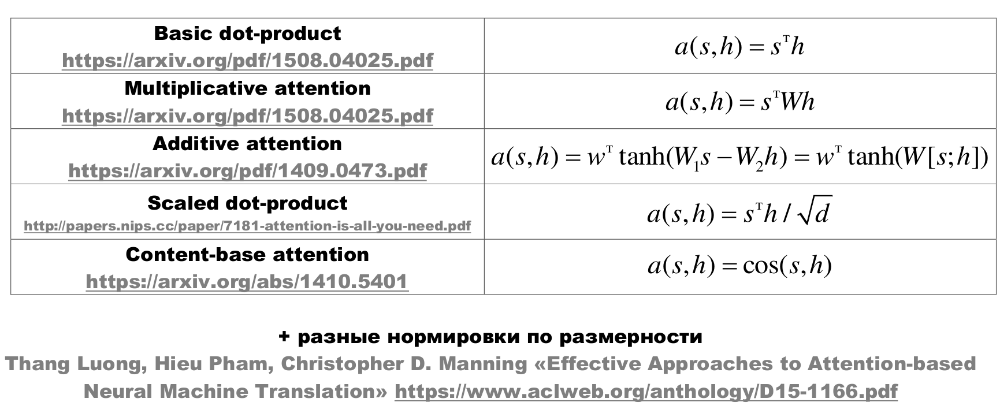

d - dimensiality of vector

### Attention mechanism one more scheme

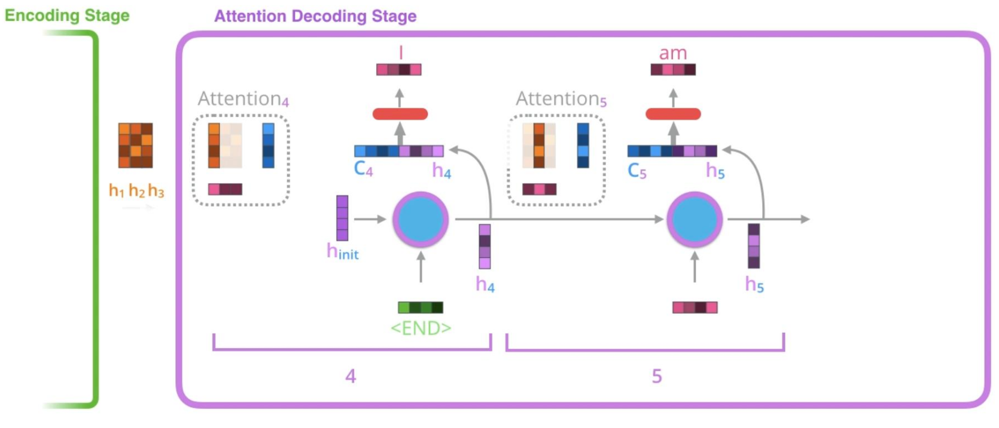

### Self-attention

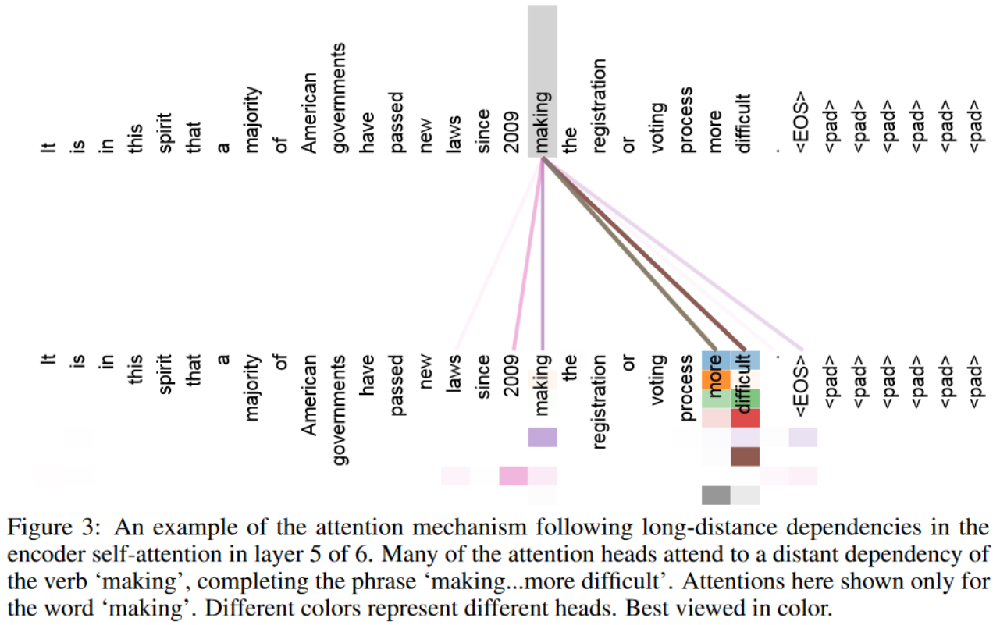

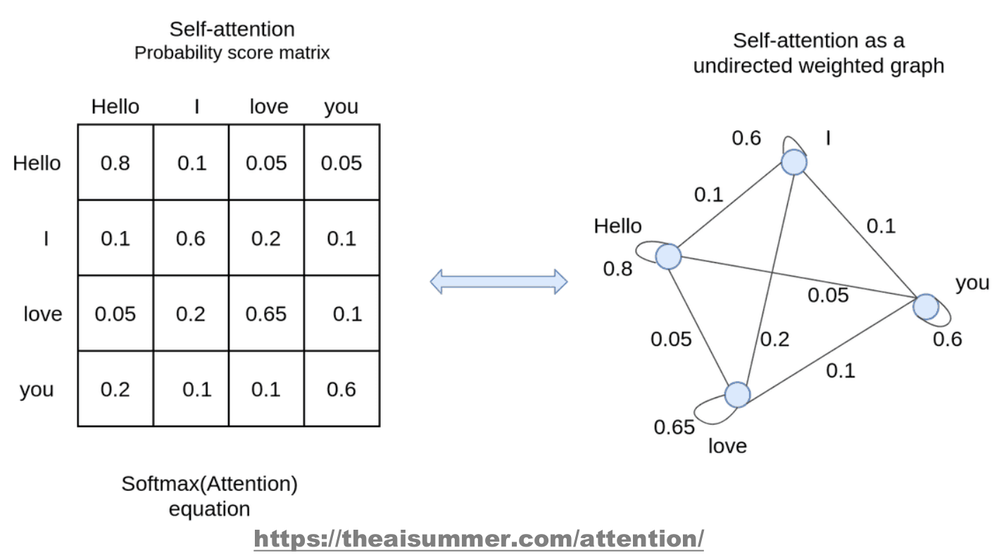

### Attention formula

Matrix V<sub>d x s</sub> contains keys

Matrix K<sub>d x s</sub> contains keys

q - query vector

d - dimensiality

s - number of objects

Dimensialities d of matrices K and V can be different

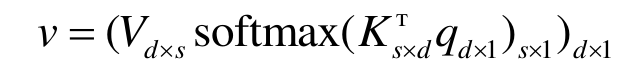

We take our query vector and multiply transposed key matrix K on it, i.e. we measure similarity between query vector and every key in key matrix. Then we use softmax to find the key vector that is the most similar to our query. Then we multiply most similar key vector and value matrix V to get our value. 

### Multi-Head Self-Attention

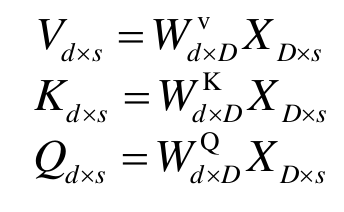

Two more matrices are added:

Matrix X<sub>D x s</sub> contains objects for attention

Matrix Q<sub>d x s</sub> contains keys

Self-atteniton formula (similar to previous). alpha = 1/sqrt(d), it's used for calculation stability.

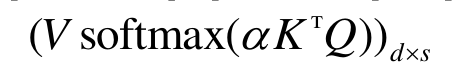

I.e. we have send s queries (with dimensiality D) to self-attention and as result get s values (with dimensiality d). Structure that performs these operations is called head.

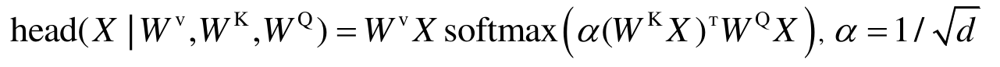

Transformer has multiple heads (e.g. 8). One head differs from another by a set of matrices W<sup>V</sup>, W<sup>K</sup>, W<sup>Q</sup>

Than results from all head are concatenated and multiplied with matrix W<sub>D x 8d</sub> 

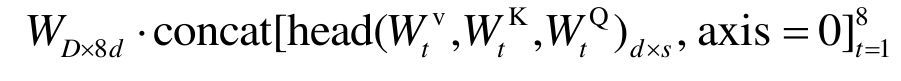

As a result we get attention matrix A<sub>D x s</sub> that has the same dimensiality as object matrix X<sub>D x s</sub>

### Attention alignment

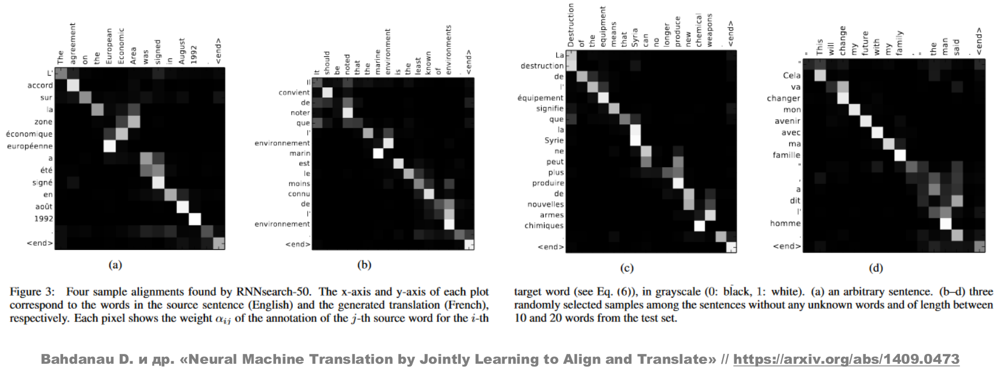

### Attention helps to solve narrow gap problem (quality deterioration for long sentences)

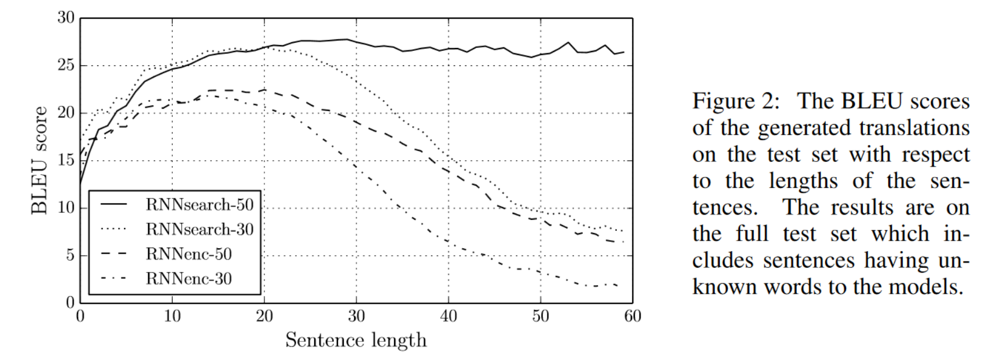

### seq2seq vs attention

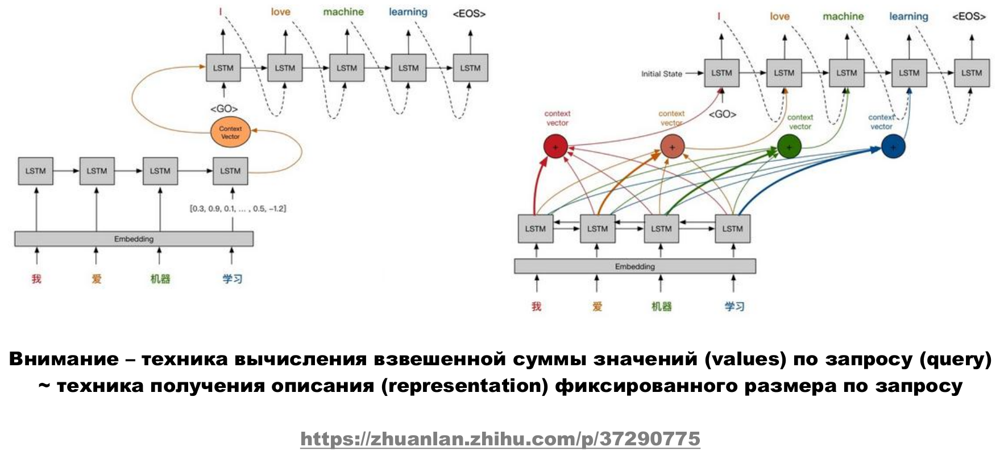

### Attention advantages

- increase translation quality
- solves narrow gap problem
- interpetable
- solves problem of vanishing gradients
- "free" alignment (correct word order) in translation (see attention alignment above)

### Attention types

- self-attention / intra-attention (attention to the different positions of the same input sequence)
- global / soft (attention to the whole output)
- local / hard (attention to the part of the output)

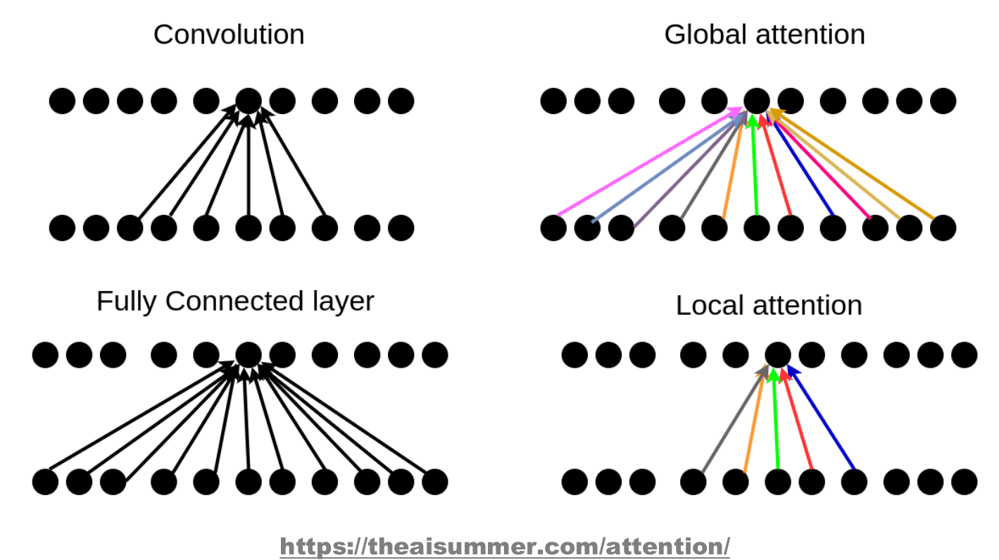

### Local attention vs global attention

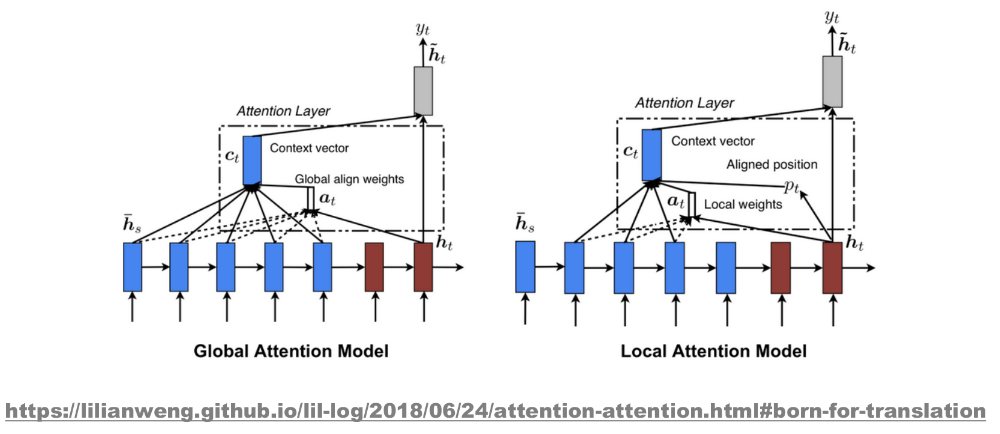

### Conclusion

- RNN - natural architecture for short sequences, no parallelization
- 1D-conv - bad for long sequences + parallelization
- self-attention - good for long sequences + parallelization but consumes a lot of memory

### More about attention here

https://lilianweng.github.io/lil-log/2018/06/24/attention-attention.html


# Transformers

Main idea: parallelized attention

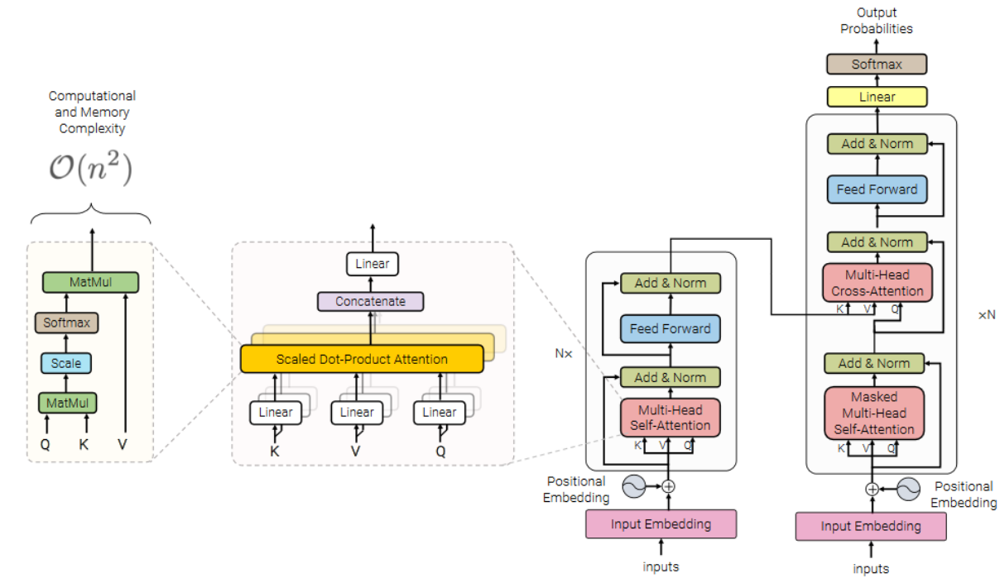

Left part is encoder, right part - decoder.



### Transformers: main

- transformer is a stacking of transformer blocks (see Self-Attention Block scheme on image above)
- diffrent heads is used for different attentions: e.g. 1st head is used to analyze words adjucent to current word (close context), 2nd is used to look for words that are connected with current word through syntax/semantics, 3rd is used to look for synonims of current word in sentence, etc.
- every next transformer layer returns more and more complex and general token embeddings (like in convolutional networks): on the first layers NN sees connections between words, on the last - "understands" meaning of words and sentences
- tokens on the output of attention block don't change their dimensions
- transformer is non-recurrent model for sequences (if we look at attention block matrices - we will see that their dimensions don't depend on number of objects *s* in sequence, so transformer block can process sequence of any length)
- transformer is a deep model with attention blocks
- last layer is softmax + cross-entropy error

### Transformer: main structure

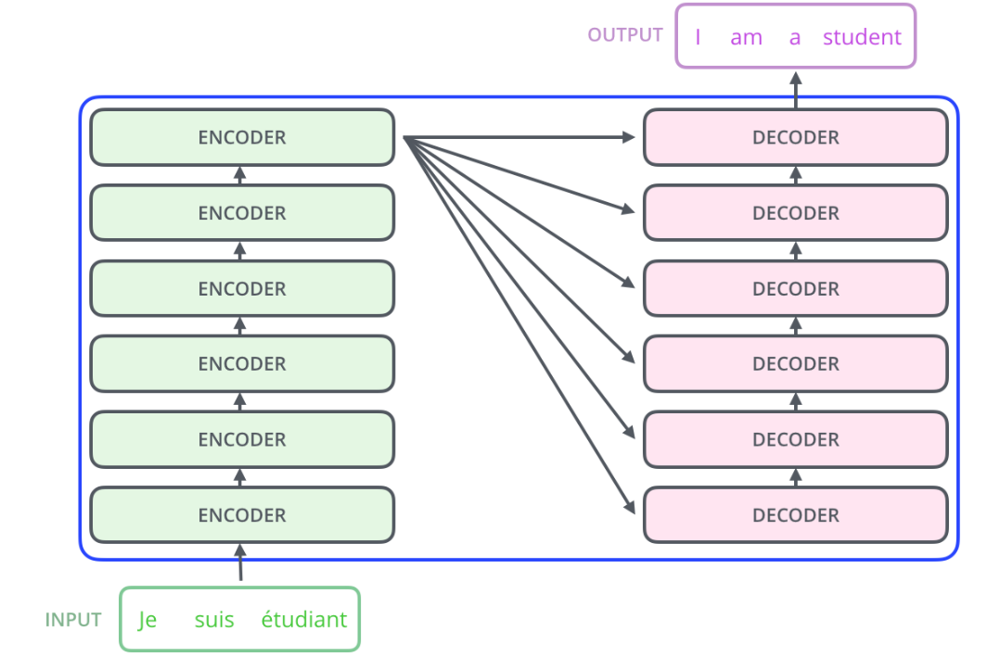

### Endcoder-Decoder structure

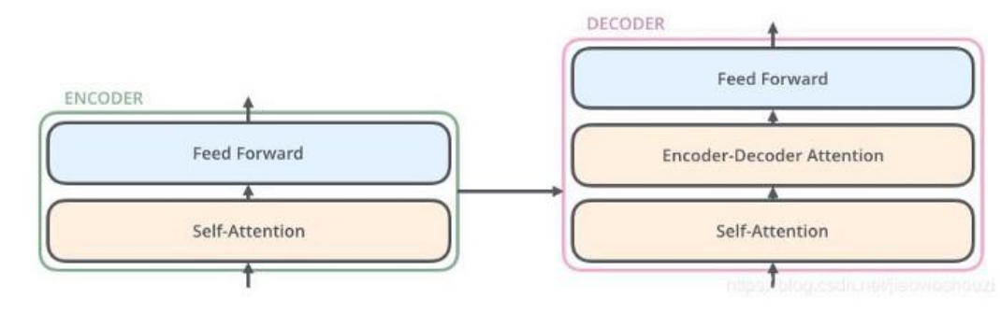

Encoder 
- 1st layer, self-attention: analyze context semantics by looking at whole sentence
- 2nd layer, feed-forward: non-linear feature space transformation

Decoder 
- 1st layer, self-attention: analyze context semantics by looking at whole sentence
- 2nd layer, self-attention: analyze context semantics by looking at whole sentence in encoder
- 3rd layer, feed-forward: non-linear feature space transformation

### Attention in transformers

Types of attention in transformers

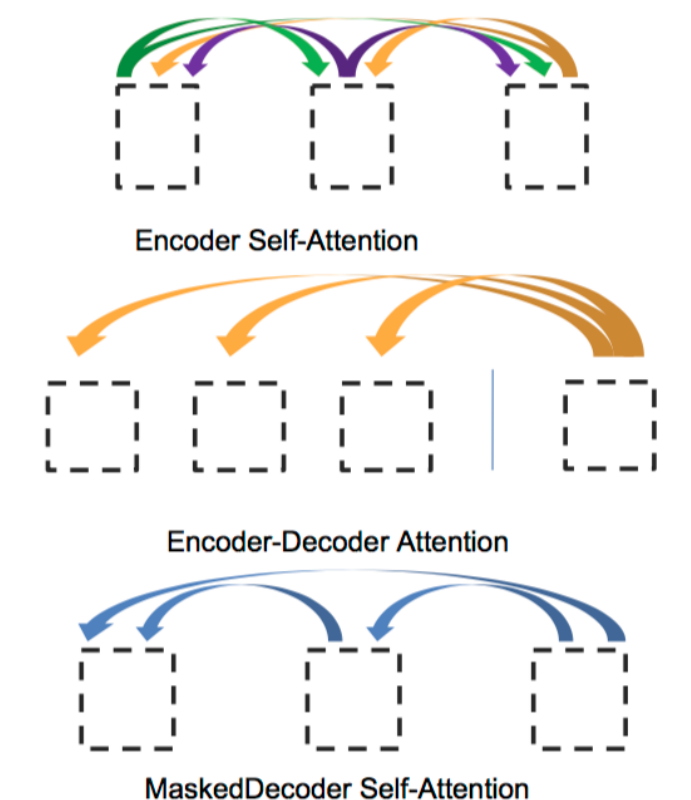

1st attention type is used in encoder, 2nd and 3rd types - in decoder

### Matrices for self-attention

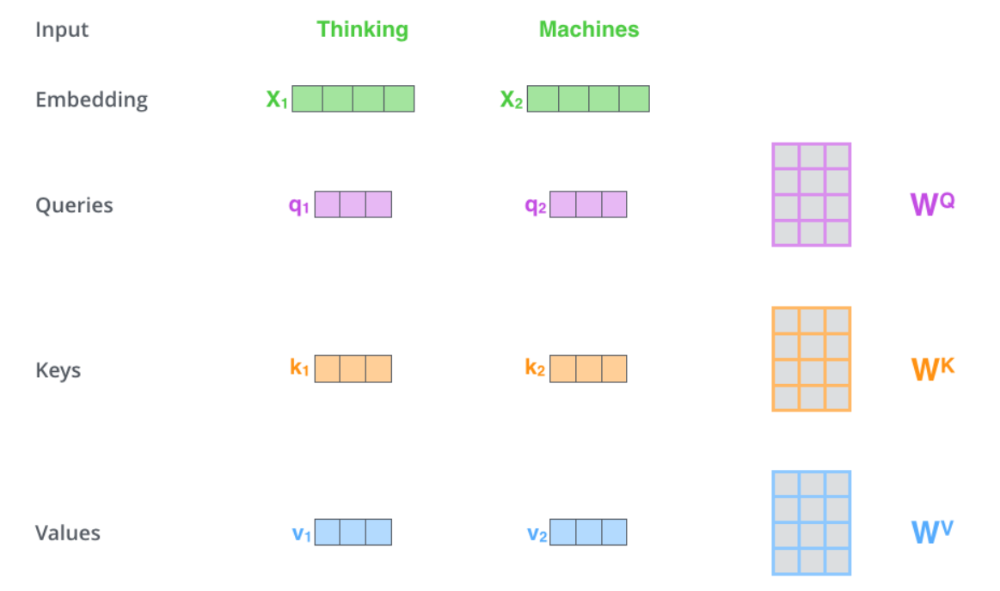

- X<sub>i</sub> dimensiality is 512
- q<sub>i</sub>, k<sub>i</sub>, v<sub>i</sub> dimensialities are 64
- q<sub>i</sub>, k<sub>i</sub> and v<sub>i</sub> are obtained by multiplying input vector X<sub>i</sub> on corresponding matrix



### Self-Attention process

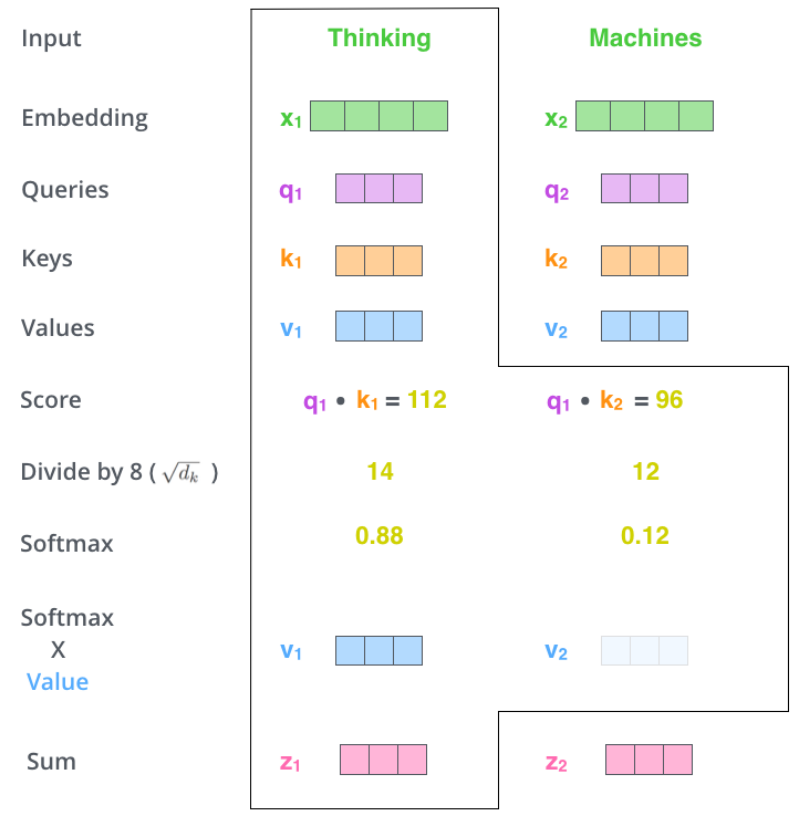

### Self-Atention process: matrix view

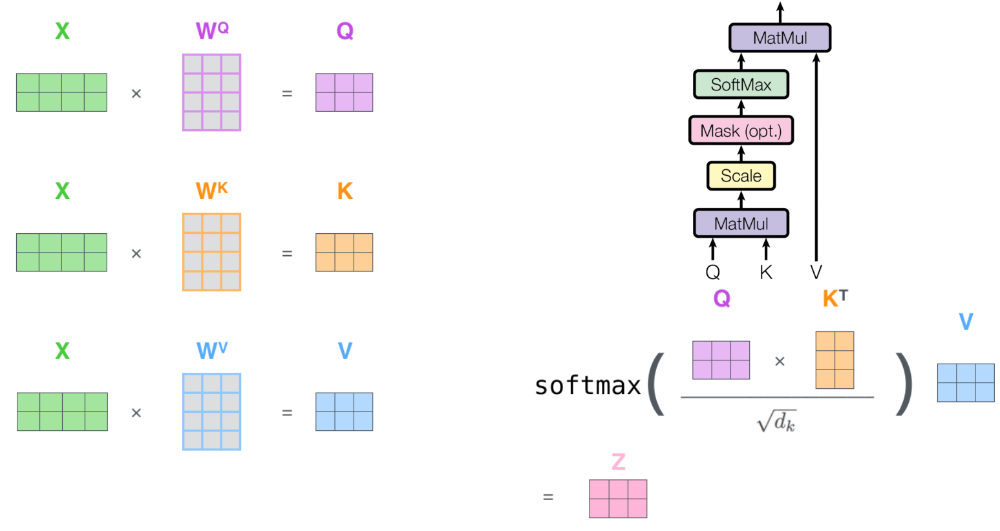

### Mutli-Headed attention: matrix view

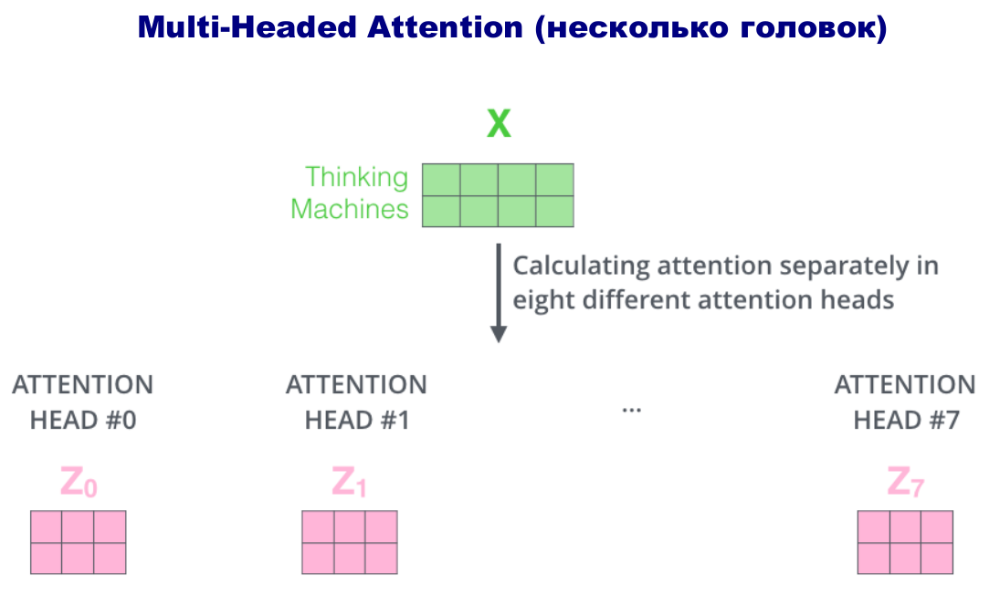

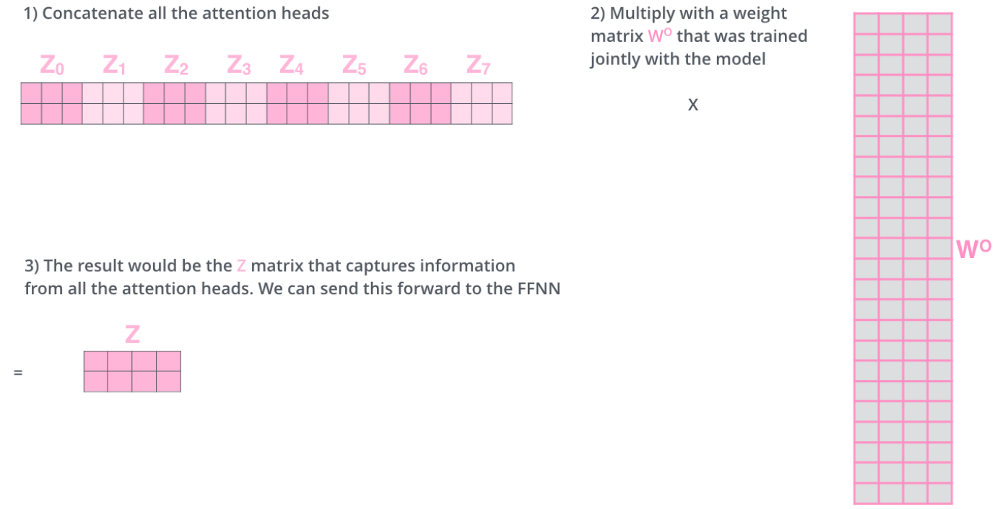

### Multi-Headed Attention: the whole process

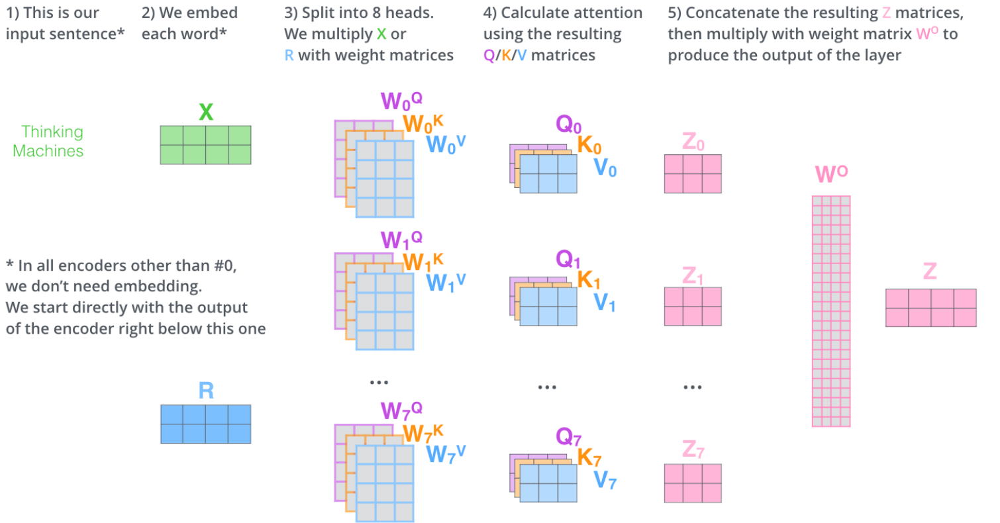

## Encoder

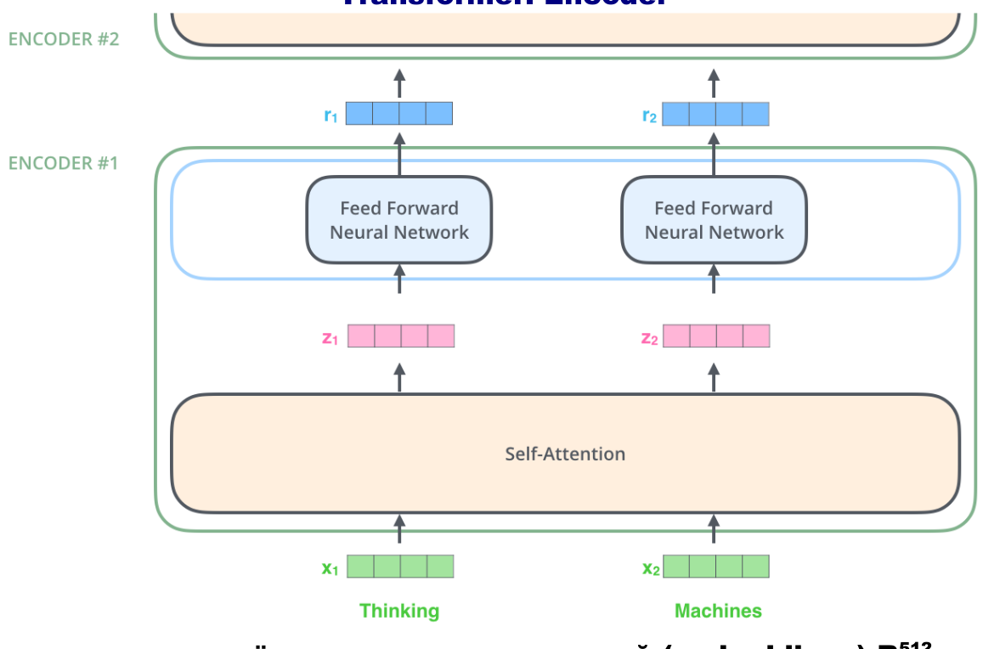

- input dimensiality is 512, output dimensiality is 512 too
- feed-forward NN is the same for any token

### Position Encoding/Embedding

Problem: unlike RNN, transformer doesn't know the order of words in sentence, so we need to encode word positions before sending them to transformer.

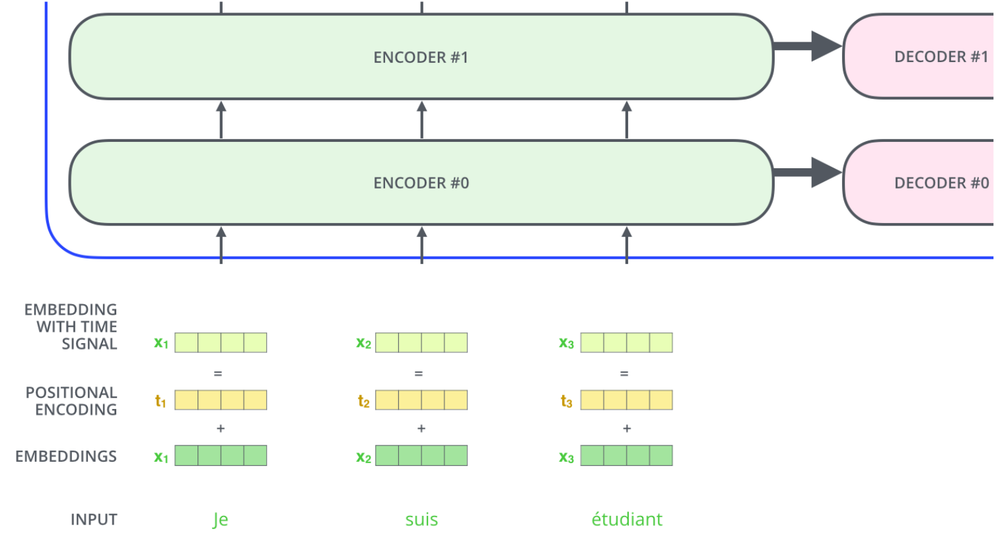

### Position Encoding mechanism

But we also need that encoding method doesn't depend on length of sentense. So for number of position *t* we make 
d-dimensional vector with values:

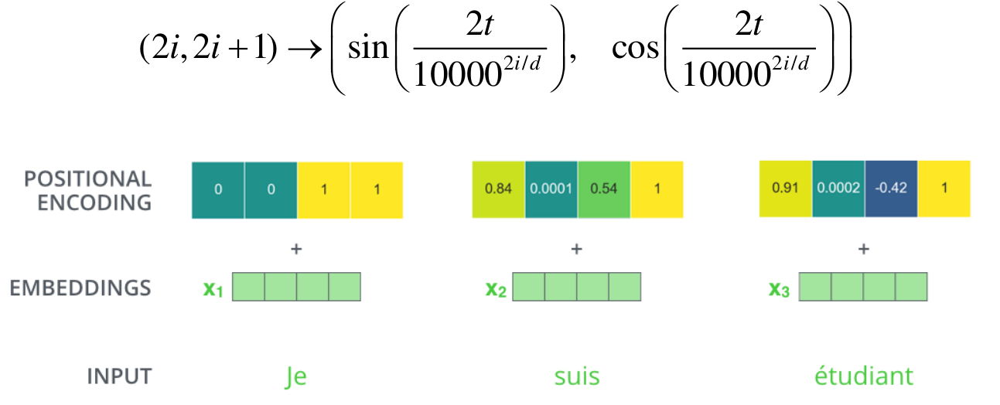

This image is made for d = 4

### Position Encoding visualization (128-dimensional encoding of 50 positions)

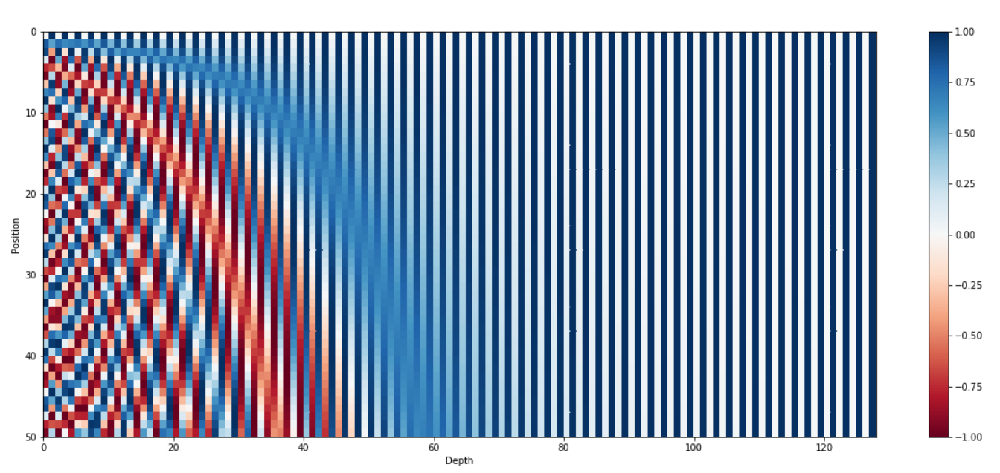

### Residual connection and layer normalization

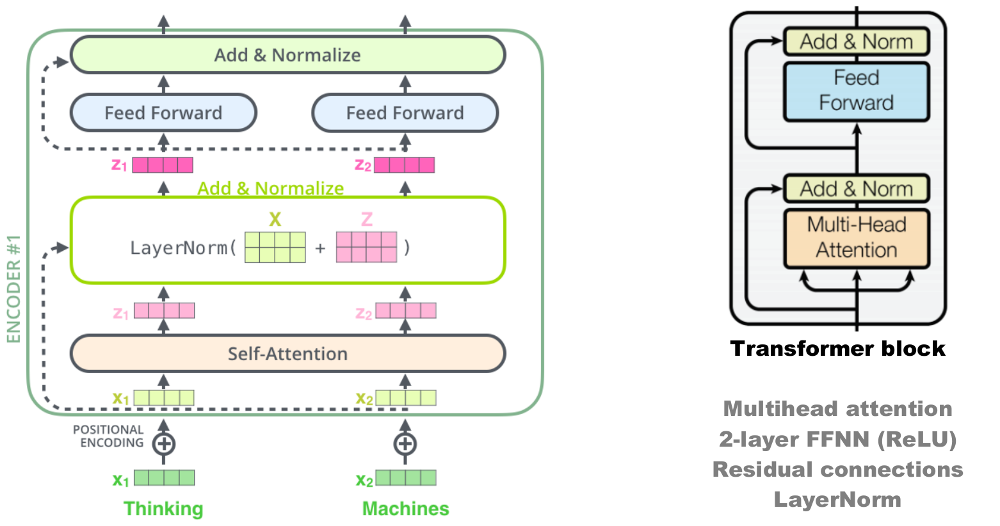

### Residual connection formula

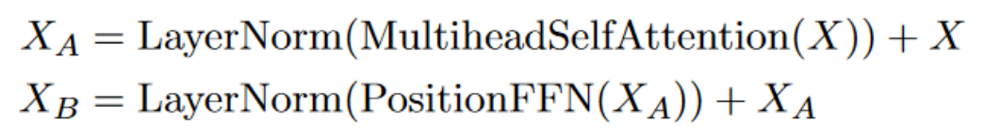

### Layer normalization formula

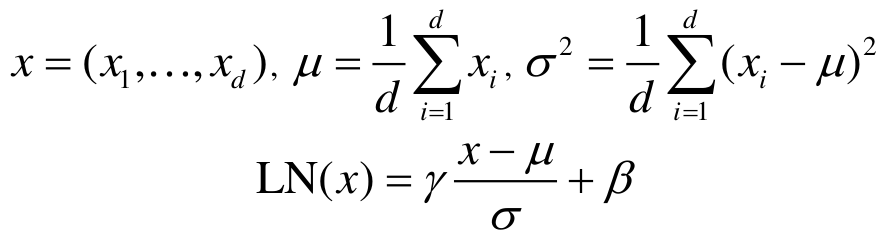

### Feed-Forward layer

Simple 2-layer NN with ReLU activation function

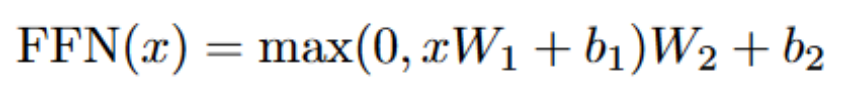

## Decoder

We don't know length of an output sequence, so we get it consequentially, token by token.

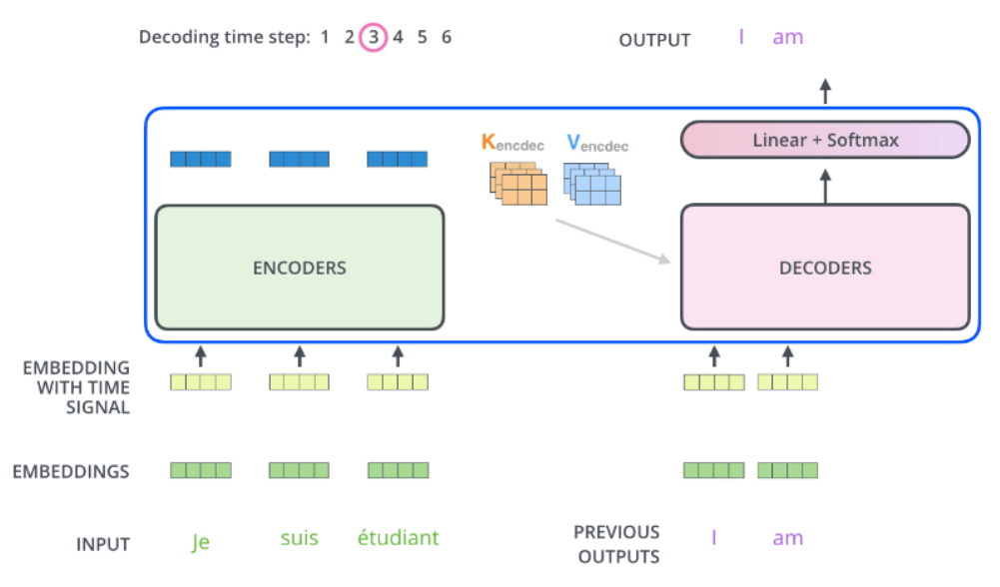

### Masked Self-Attention

#### Padding mask

Mask end tokens of sequences with zero.

#### Sequence mask

Problem: decoder isn't allowed to see future answers during training to avoid data leakage. So we use masked multi-head attention, that masks all decoder tokens that will appear after current token.

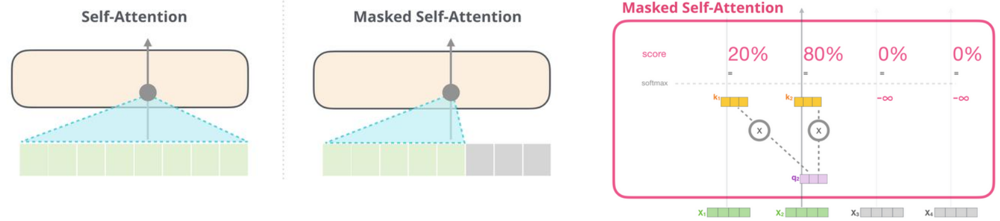

Sequence mask is implemented by adding upper-triangular mask filled with very small values (like -inf or -1e9 to make softmax for these values to be ~ 0) on self-attention weight matrix.

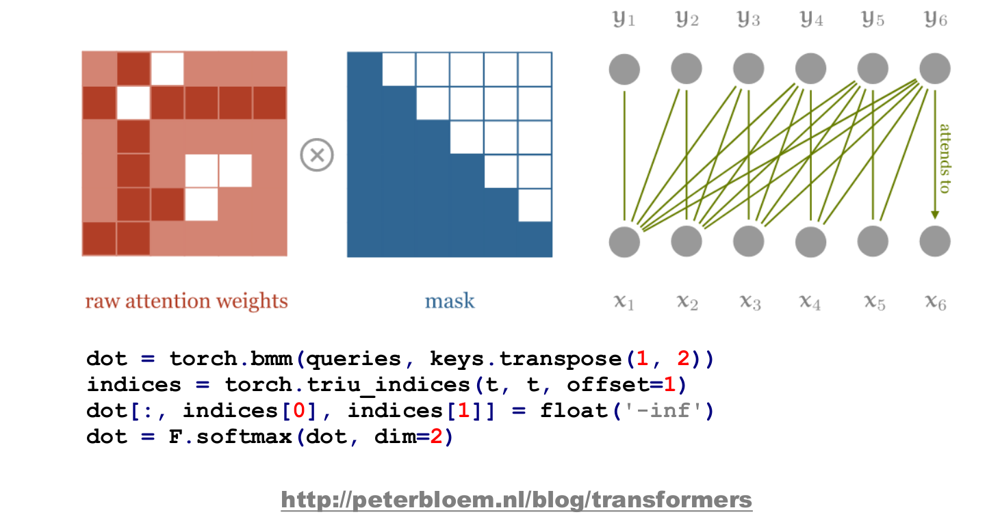

## Output layer

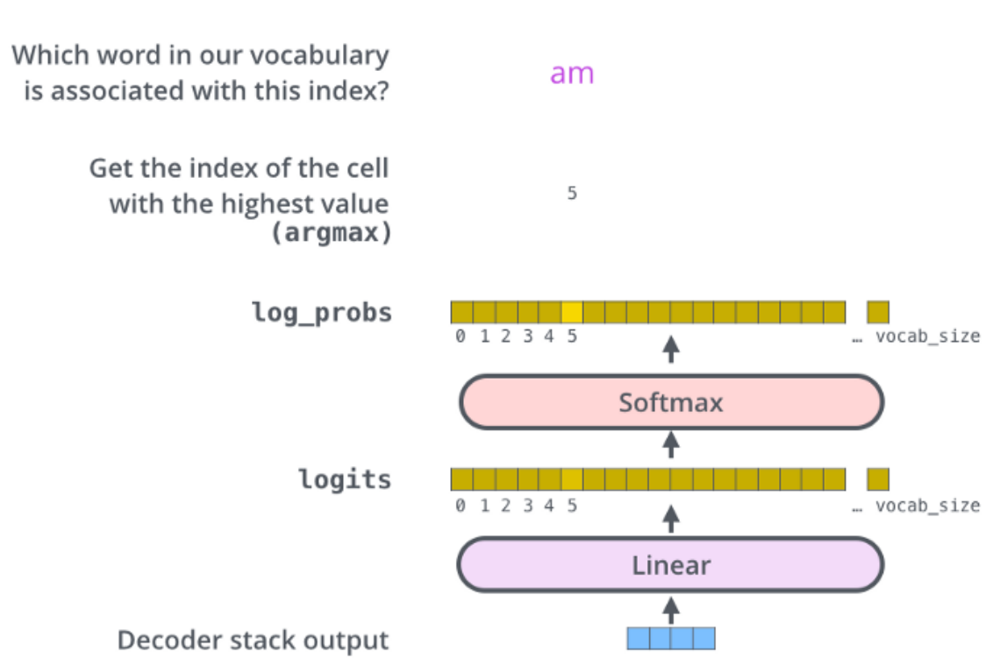

Greedy strategy of output word selection isn't the best.

# Transform training

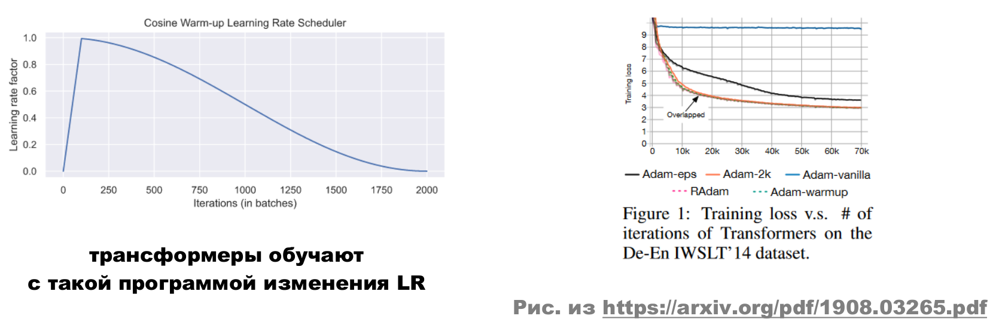

 - use warm up (gradual increasing of LR) on first training epochs, then slowly decrease LR 
 - warn up is used because on first iteration huge LR values can lead to rapid increasing of gradient values caused by Layer Norm module, so training may become unstable
 - after warm up is over - begin to gradually decrease LR on every iteration
 - also warm up is used because Adam optimizer can increase variance on the first iterations, so we need small LR at first

## Learning Rate & Batch Size

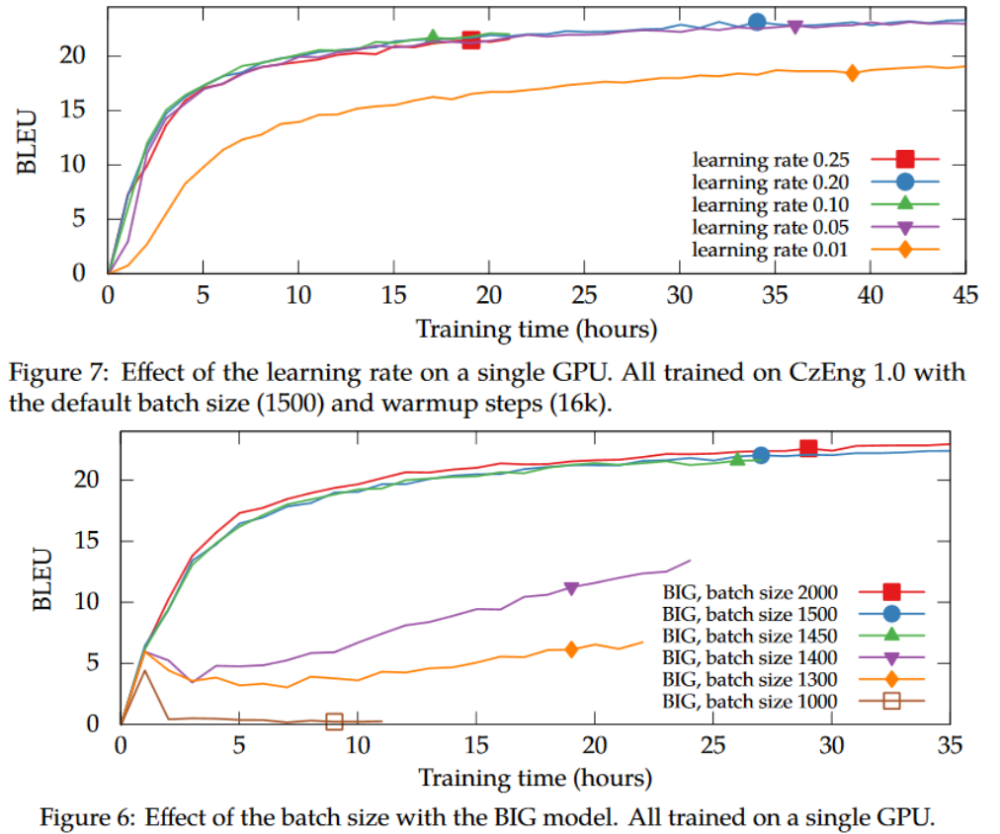

Bigger batch size lets to put longer sequences in it, that leads to increasing of quality.

## Sequence length

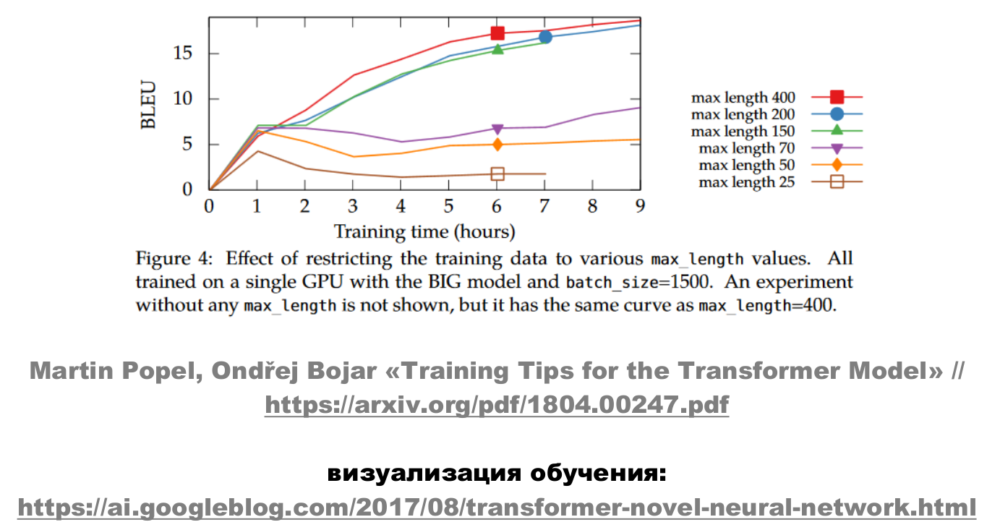

The longer sequence - the better results (see more context)

# BERT

BERT = Bidirectional Encoder Representations from Transformers

- transformer NN for pretraining of language models and obtaining of word representations
- main idea: take LM (language model), train in on huge text set and then fine tune for different specific tasks
- uses encoder only (encoder + decoder is used for complex tasks like machine translation, for word representation encoder without decoder is enough)
- bidirectional

### Problem of bidirectionality

When NN processes context bidirectionally, data leakage appears and NN just learns to look forward for next word prediction. 

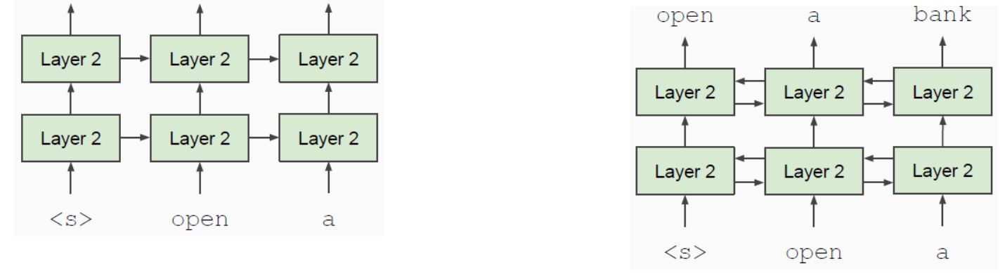

### How to solve? 

### MLM (Mask Language Model)

Mask 15% of randomly chosen tokens and predict them.

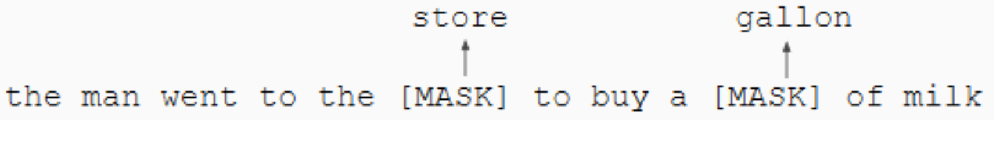

p = 0.8 - replace with [MASK]

went to the store → went to the [MASK]

p = 0.1 - replace with random word

went to the store → went to the running

p = 0.1 - do nothing

went to the store → went to the store

### Next sentence prediction (NSP)

Find if sentence B follows after sentence A or not.

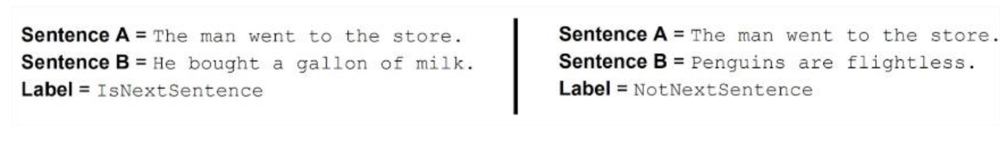

Class ratio = 50/50 

### BERT: Input representation

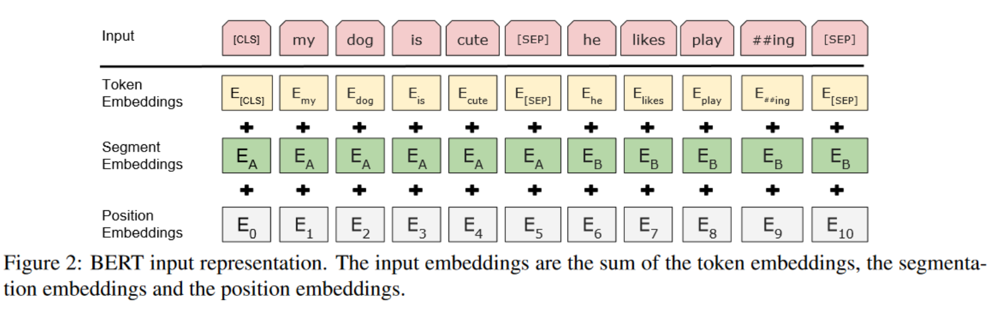


Each token is sum of 3 embeddings: token embeddings + segment embeddings (show boudaries of sentences) + position embeddings

Some token can be separated by two (like play and ##ing - BPE or WordPiece tokenization) 

Two sentences are separated with special symbol [SEP]

All embeddings can be trained

### BERT details

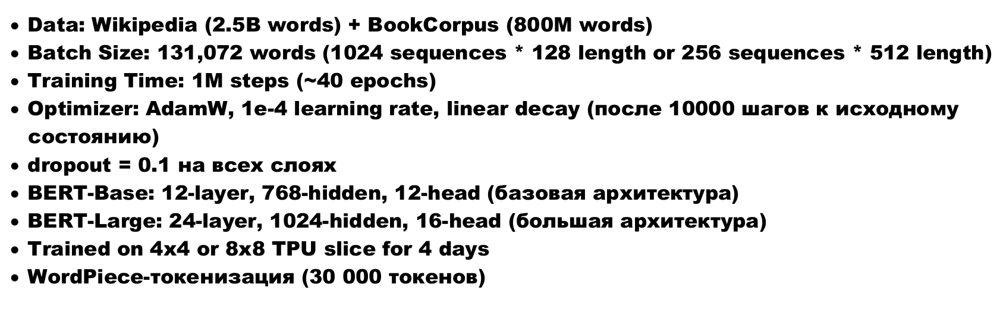

## BERT: fine tuning scheme

### Sentence classification (positive or negative)

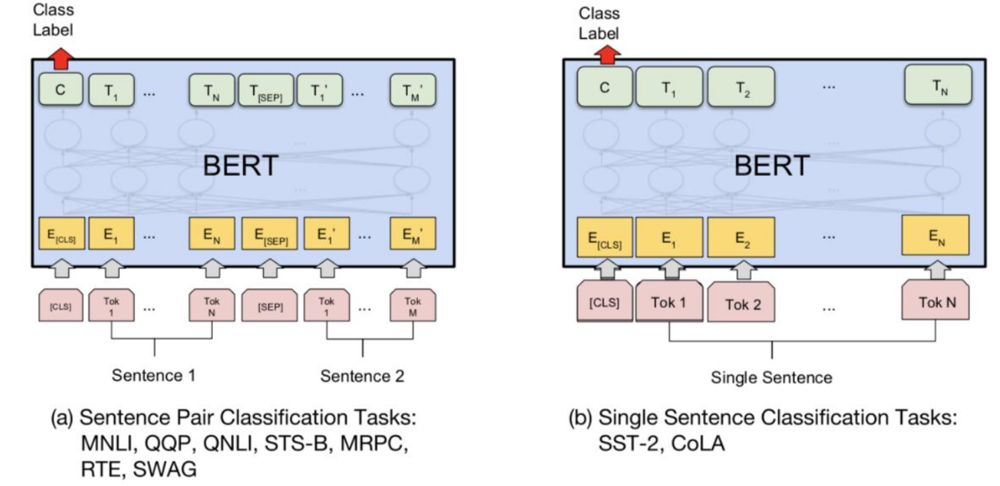

For classification let's take final state of token [CLS], multiply it on trainable matrix and use softmax.

### QA & Tagging

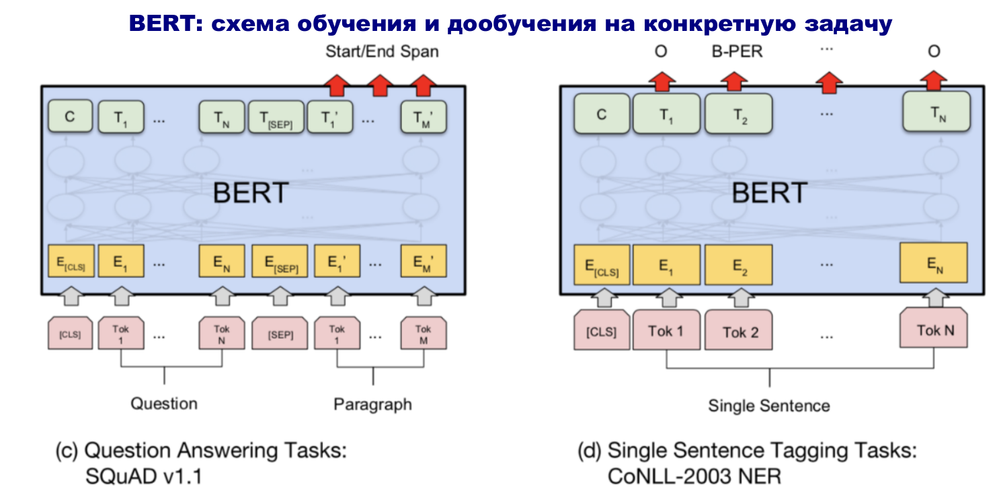

QA: answer is piece of text - for every token model predicts probability of being begin and end of answer. Trainable parameters - 2 matrices which are multiplied by token states with softmax.

Tagging: use classifier (trainable matrix + softmax) for every token and fine tune it on tagged text corpus.

Removing of some pre-training tasks decreases BERT accuracy significantly.

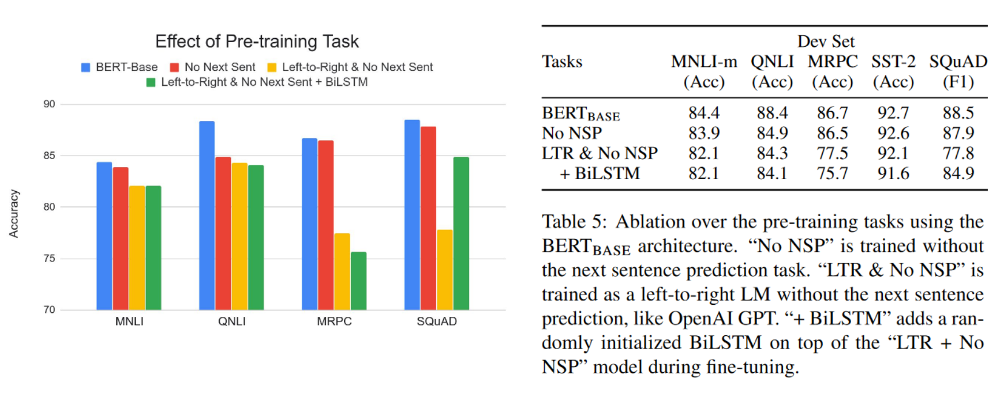

### BERT: effect of model size

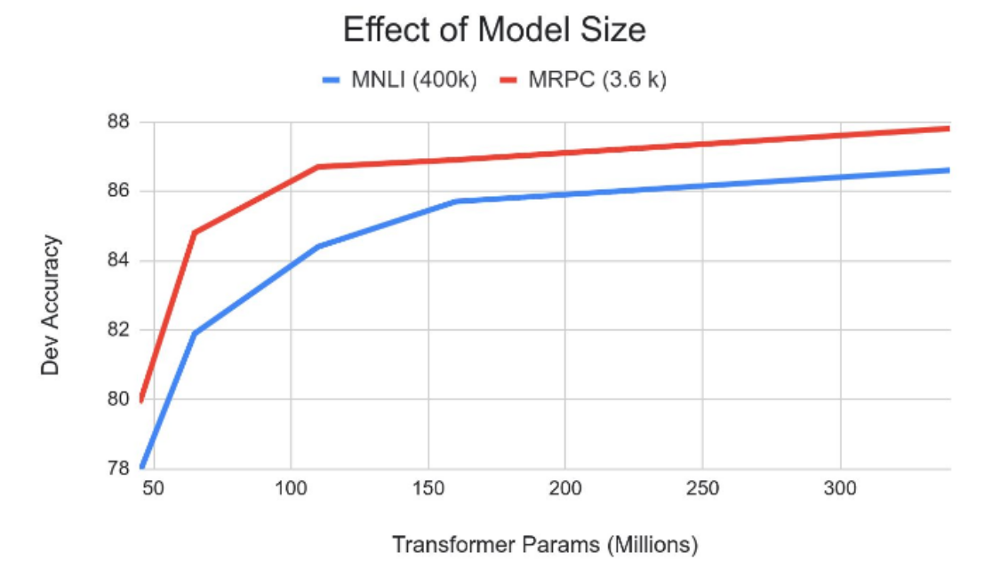

Accuracy doesn't reach asymptote with increasing of parameters number event for small datasets.

### BERT: results

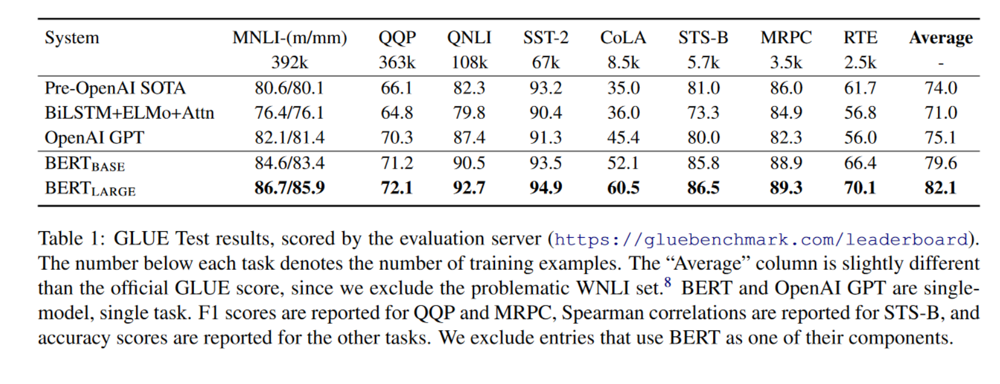

### BERT: what layers
should be used for word representation?

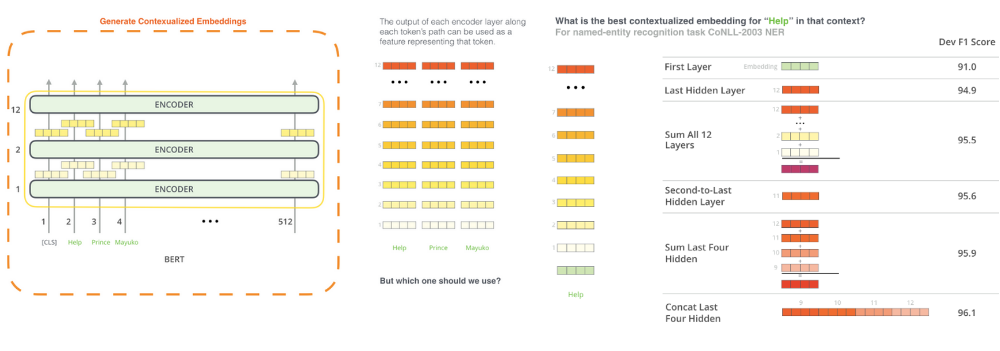

Combining (sum, concat) of layer states increases model accuracy.

# RoBERTa

- better than BERT
- SOTA in many NLP tasks
- architechture wasn't change
- additional BERT training because BERT is significantly underfit:
    - increase train data size: 16GB → 160GB
    - increase batches: 256 → 8k
    - longer sentences
    - remove next sentence prediction objective (NSP)
    - dynamic masking for every sample (mask is created when sentence gets to input, in BERT it's formed preliminary)
    - increase BPE encoding

# ALBERT - A Lite BERT

- squeezed BERT: x18 less parameters
- trains 1.7 times faster
- ligth in terms of parameters, not in terms of speed
- better than RoBERTa in some tasks (e.g. RACE)

### How in was squeezed?

- factorize WordPiece matrix from 1024 x 100k to 128 x 100k and 1024 x 128

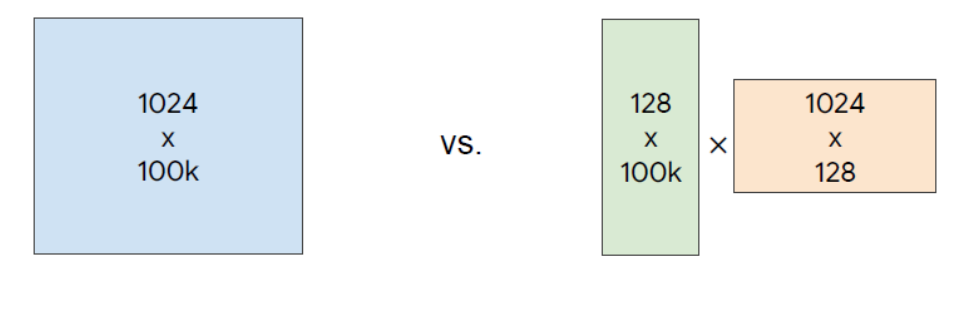

- Sentence-Order-Prediction (SOP): NSP task is easy, take sentences from one document and put them in correct/incorrect order 
- Cross-Layer Parameter Sharing (same parameters in different layers) - slightly decreases quality but also decreases parameters number

# DistilBERT

 - main idea: model-student studies to reproduce answers (in this case answer is distribution of class probabilities) of model-teacher BERT (this process is called distillation)
 - model-student has twice less layers (one of each layer pair is selected)
 - same initialization as in BERT
 - complex loss function

# T5

Full text2text transformer (encoder + decoder)

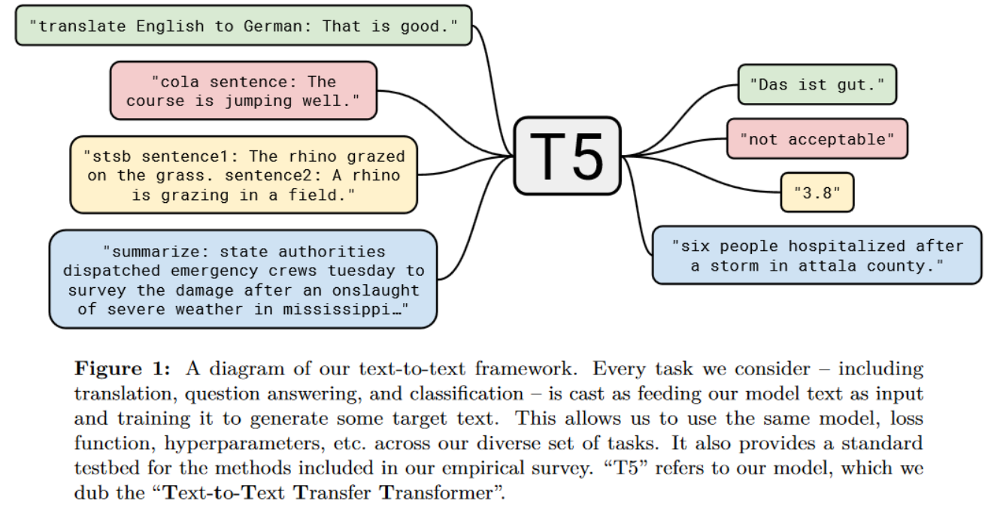

- use C4 dataset (big and good - 745 GB), don't use Wiki because it's good but monotonous and small
- clear C4:
    - delete duplicates
    - delete incomplete sentences
    - delete noise and obscene language

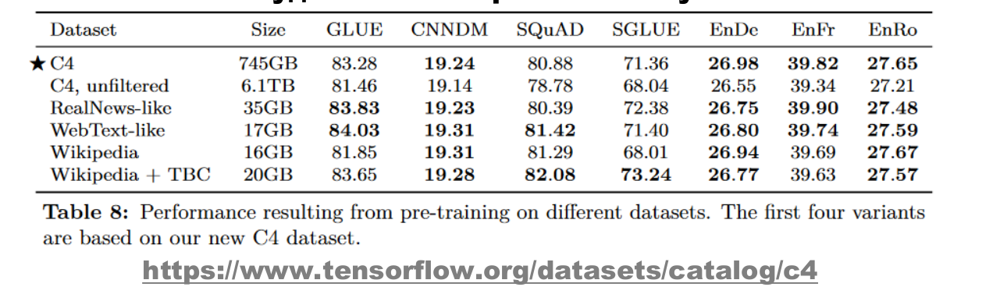

- research architechtures and find out than encoder-decoder is the best
- pretrain on unlabeled datasets (from the same domen as labeled data)
- different training strategies: multitask learning ~ pre-train-then-fine-tune approach
- scaling
- details here https://arxiv.org/abs/1910.10683

Results: pre-training is a power

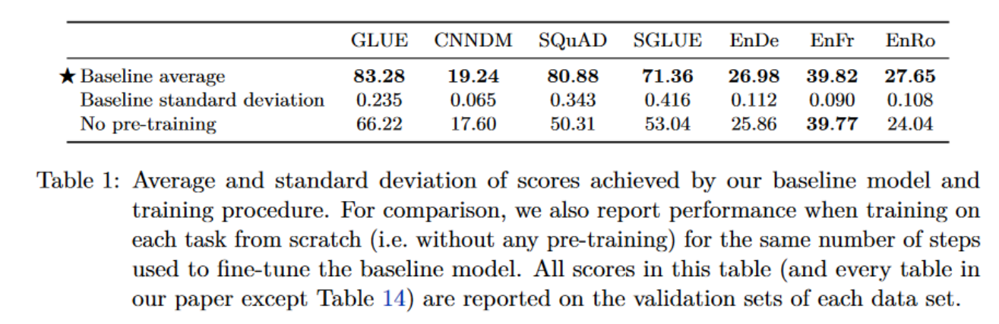

### T5: masking

Use masking, 2 or more consequtive word can be masked with one mask

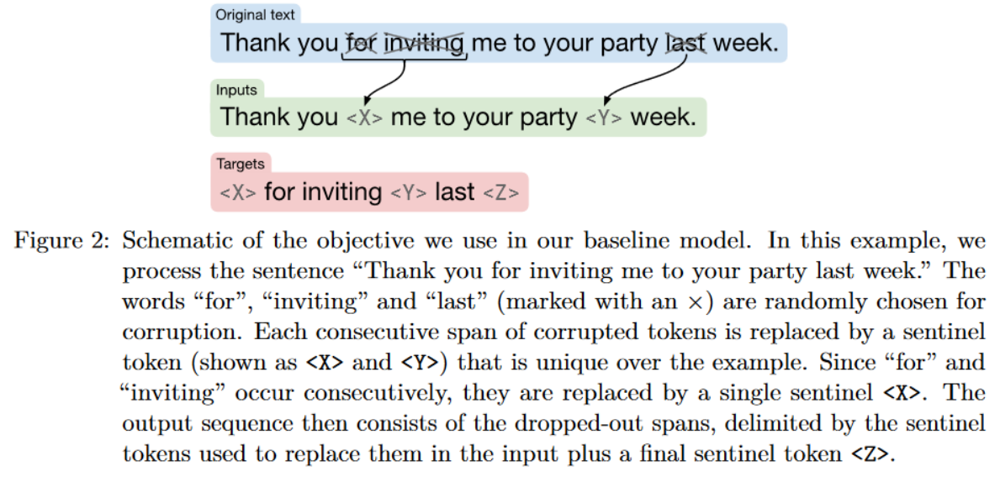

Many different masking types were used

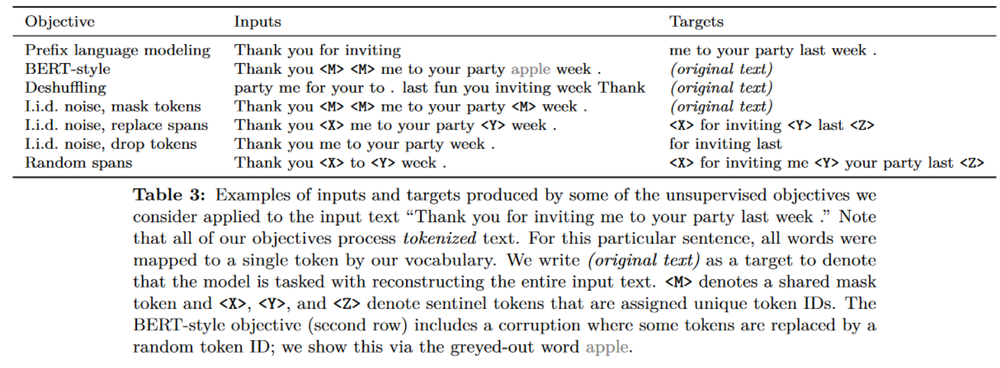

Best corruption rate is 15%, best masking type is random spans

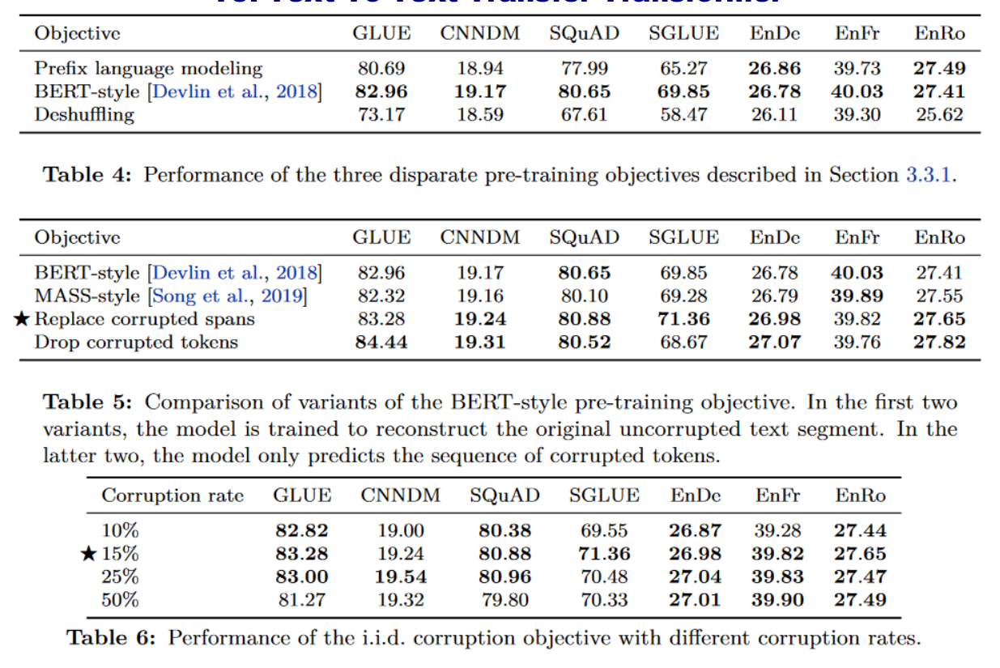

# ELECTRA = Efficiently Learning an Encoder that Classifies Token Replacements Accurately

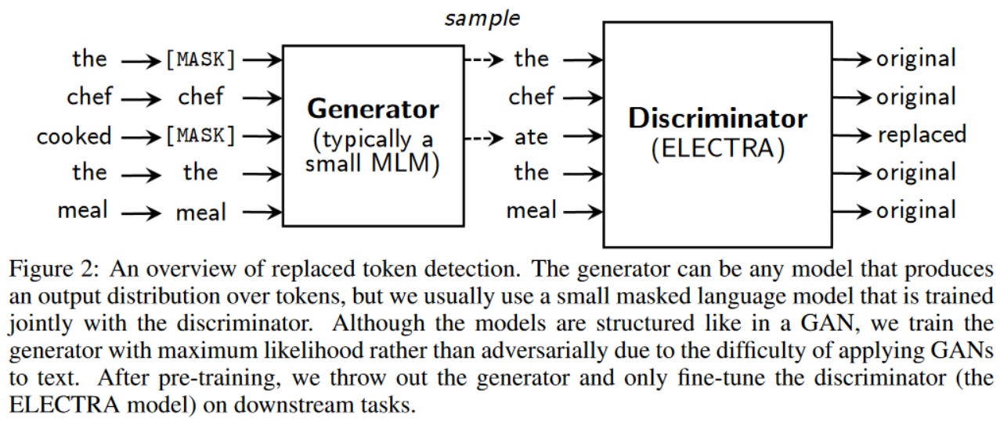

 - main idea: instead of BERT-like masking replace some tokens by generator model and try to find replaces with discriminator model
 - bidirectional model but it's trained with all tokens (not 15% of masked ones)
 - generator is small model (2-4x smaller than discriminator)
 - generator loss function:
 
 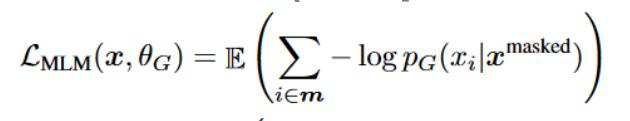
 
 - discriminator loss function
 
 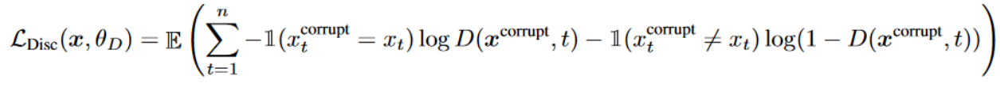
 
 - both generator and discriminator are transformers
 - no MASK tokens
 - weight sharing for input embeddings between generator and discriminator (to decrease number of parameters)
 - trains fast (4 days on 1 GPU and better than GPT)
 - more info here https://openreview.net/pdf?id=r1xMH1BtvB

### ELECTRA: results

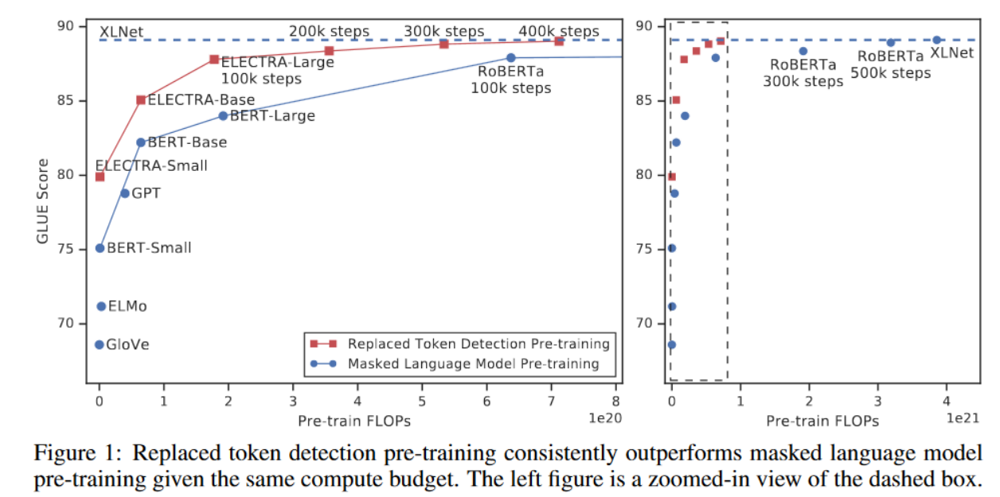

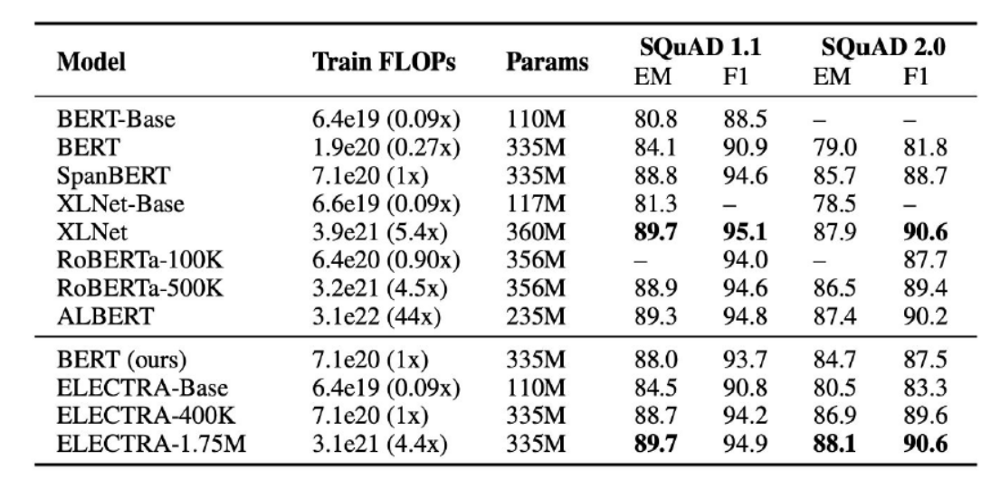

# NLP models benchmarks (2023)

### SQUAD 2.0

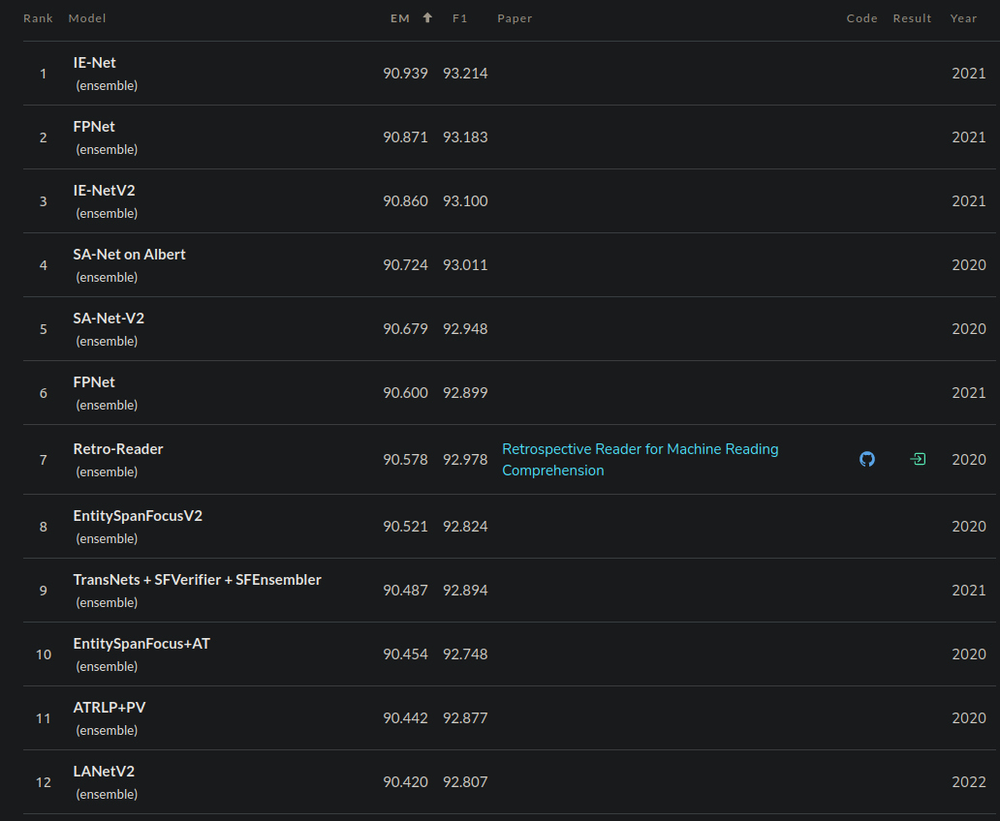


### GLUE

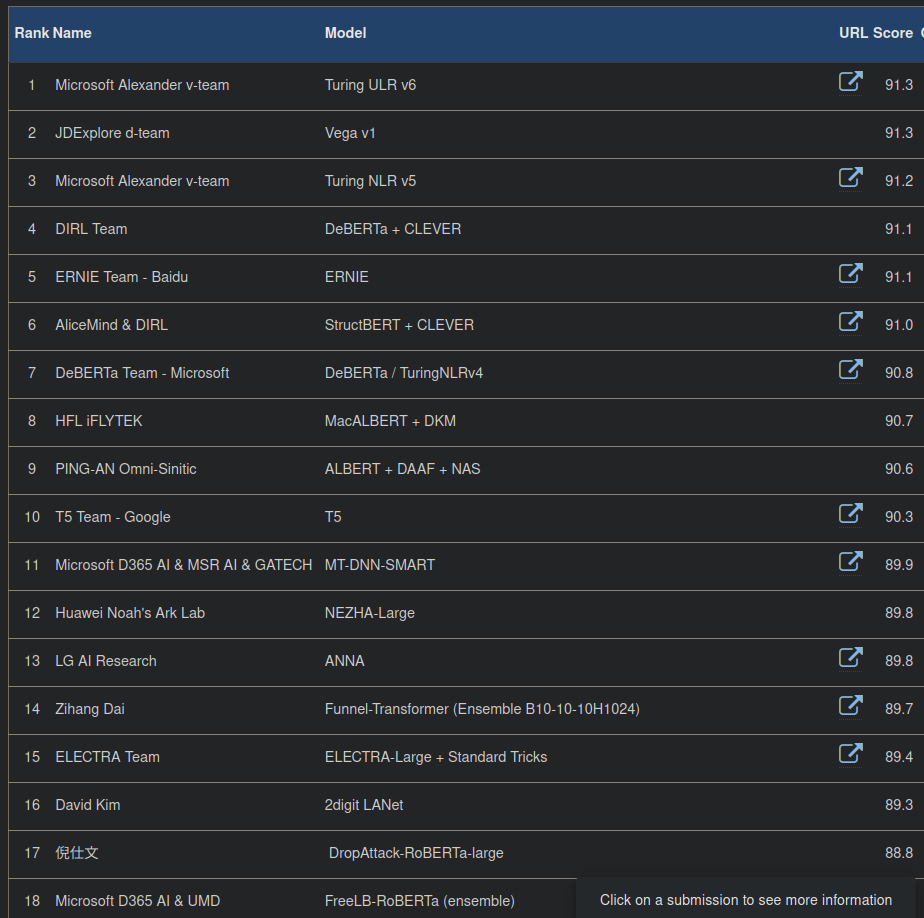

### SuperGLUE

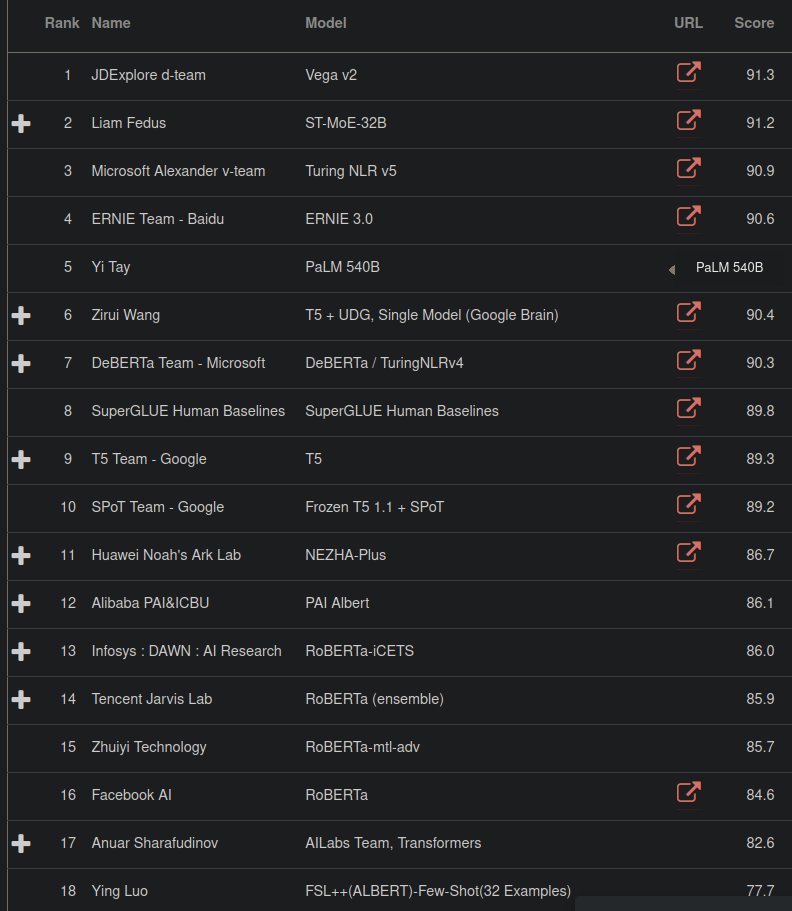

# BERT family

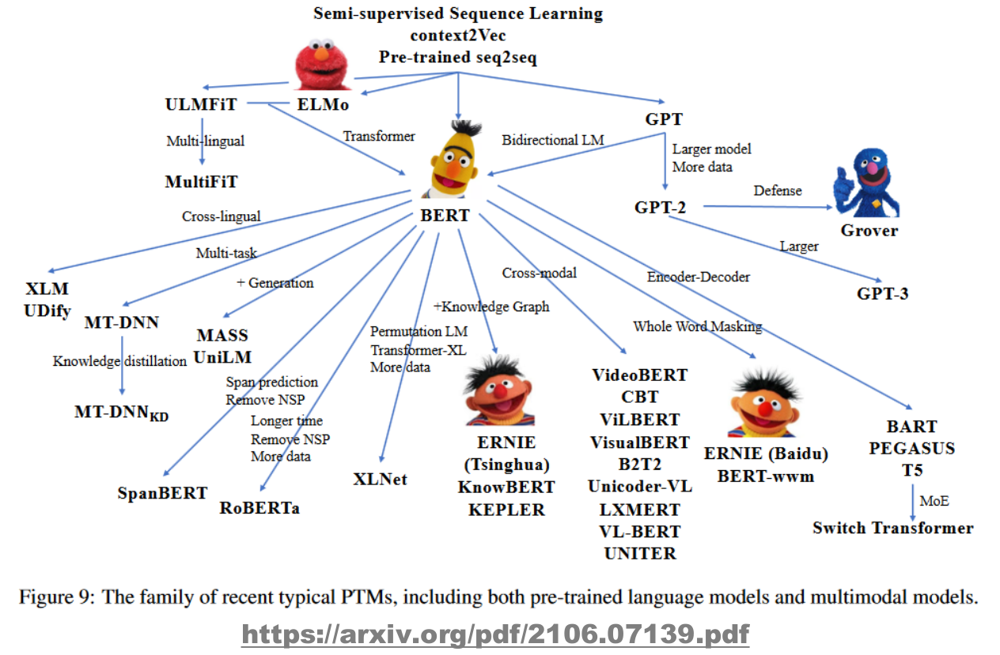

# BERT vs GPT vs ELMo

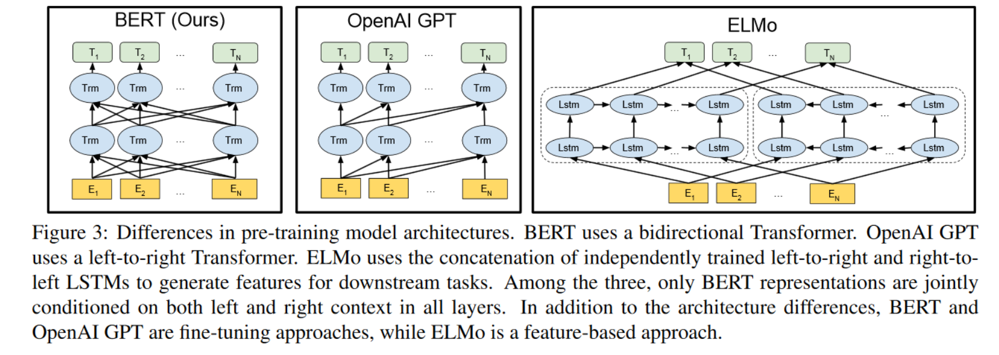

# Transformers: conclusion

- transformer - original non-recurrent architechture
- almost all SOTA a based on transformer architechture

Trends:
- train on huge text corpus
- transfer learning: pretrain on task with big data and cheap markup, then fine-tune model for specific task
- simplify: decreasing number of parameters and layers
- for those who wants look at transformer more closely - code with explanation http://nlp.seas.harvard.edu/2018/04/03/attention.html

# Language Models

# ERNIE (Enhanced Representation through kNowledge IntEgration)

- WordPiece model
- Pretrained BERT is used
- tested for different tasks (natural language inference / semantic similarity / named entity recognition / sentiment analysis / question-answer matching)
- result is better than BERT
- more info here https://arxiv.org/abs/1904.09223

### Architechture

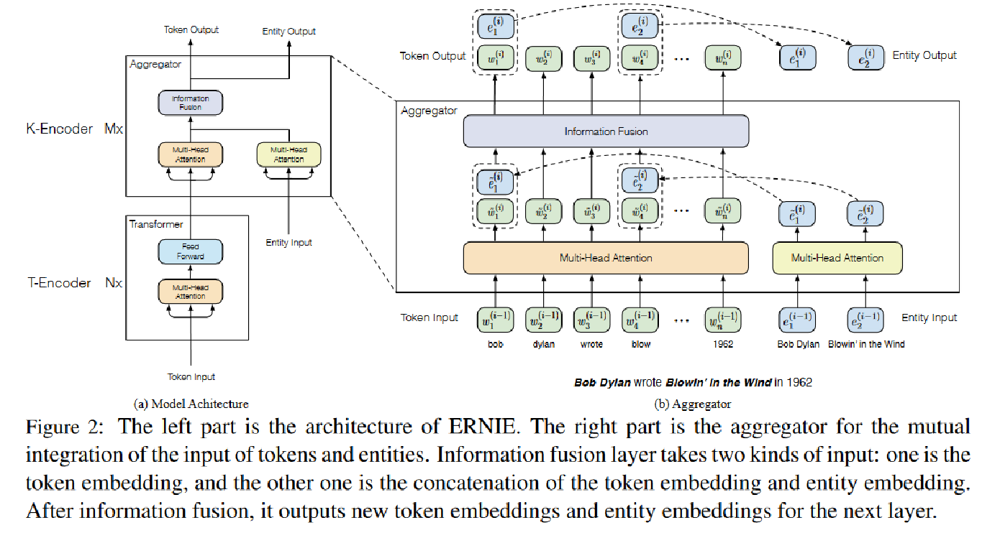

- use two encoders: T-endcoder and K-encoder 
- T-Encoder is a classic transformer encoder
- K-encoder uses 2 Multi-Head Attention modules: one for words and one for entities + fusion layer
- entitiy is an additional extra knowledge information that is used to make the model to "understand" text better

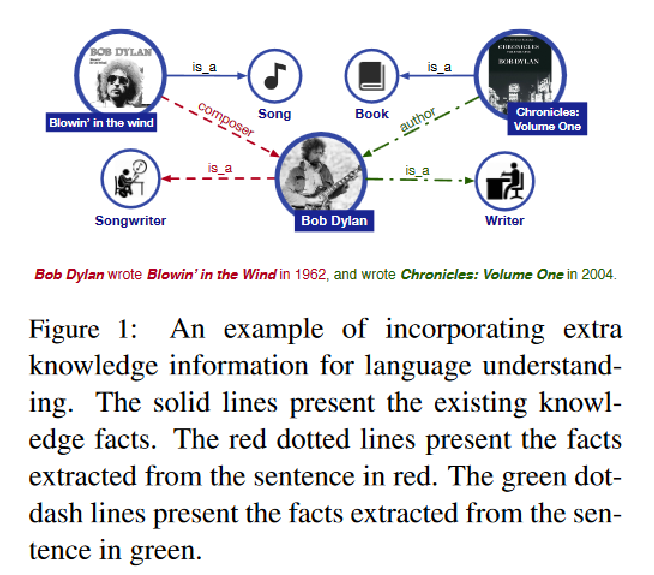

- fusion layer is used for mutual integration of the token and entitiy sequence

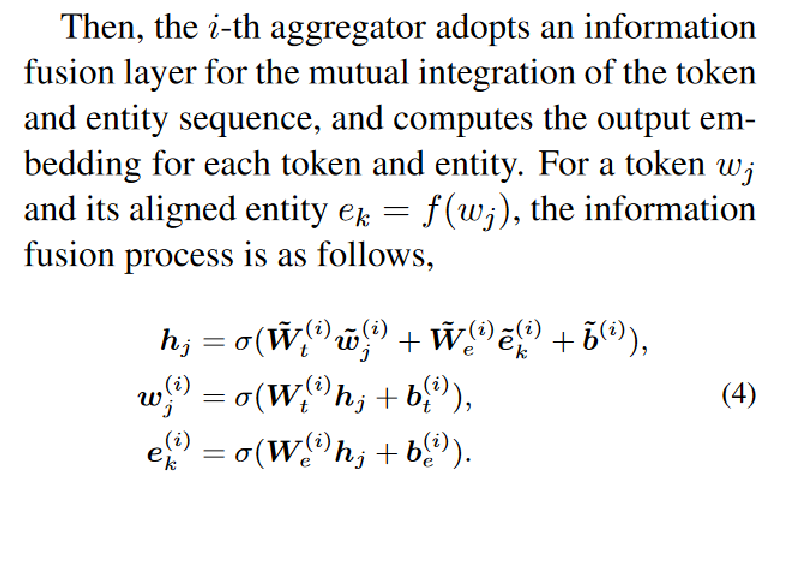

### Training

3 tasks:
- MLM (Masked Language Model)
- NSP (Next sentence prediction)
- Knowledge Pretraining Task (dEA) - randomly mask token-entity alignments and predict corresponding entity for a token from the entities in the sequence; need data with annotated entities (Wikipedia)

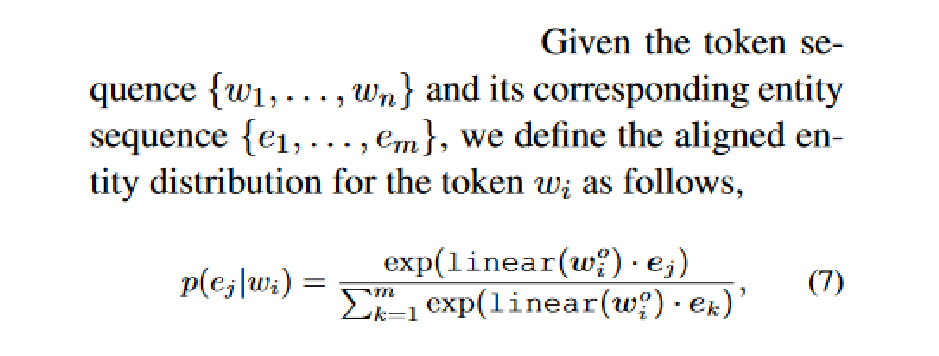

### Masking

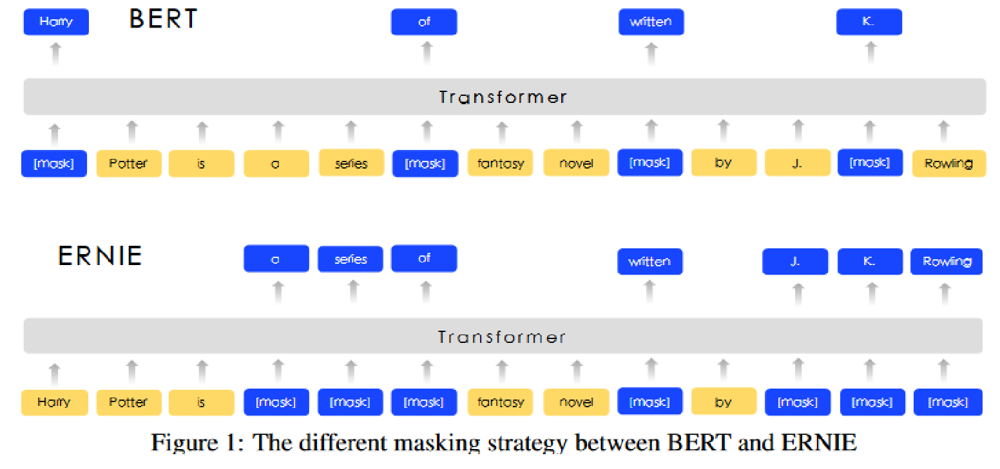

Knowledge masking: mask words on the first layer, entities (like J.K.Rowling, Eifel Tower, etc.) on the second and phrases on the third. That is used because model can easily restore entity/phrase if you mask only part of it, so it won't learn anything. So you should mask this entity/phrase completely.

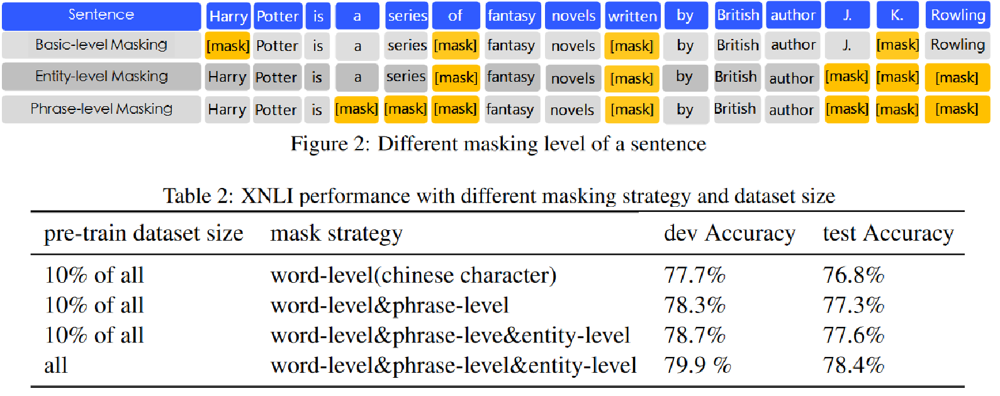

# GPT - Generative Pre-Training

- transformer-decoder, 12 layers, 12 heads
- unidirectional, masked self-attention
- predict next word
- BPE-encoding
- d=768 for token encoding
- GELU
- 100 epochs 
- 64 in the batch, 512 tokens
- supervised fine-tuning - 3 epochs

### Architechture

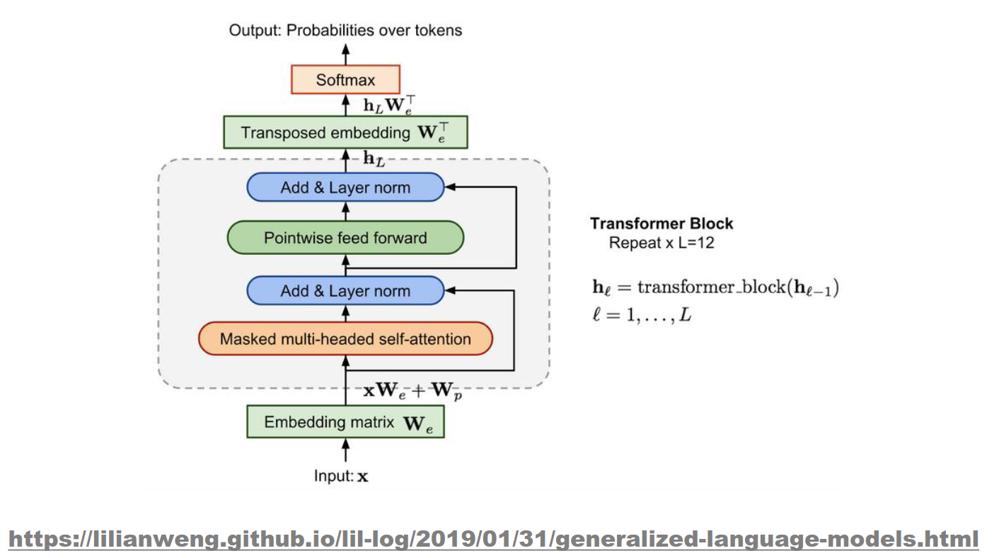

Transformer vs GPT vs BERT

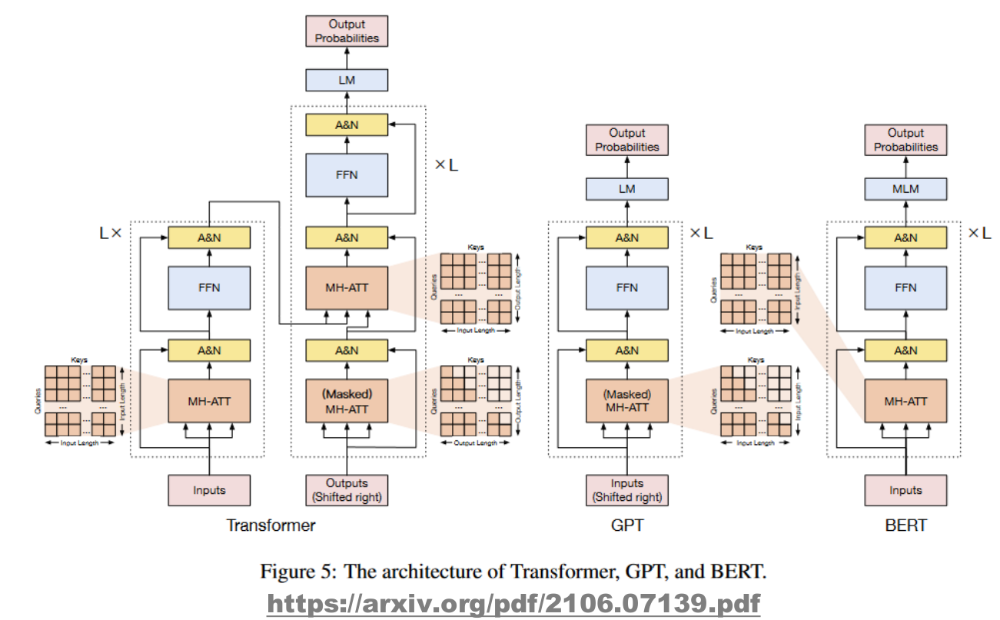

GPT - mutlitask archtechture. Any task doesn't require architechture changing. If task demands multiple sentences - they are separated with special token.

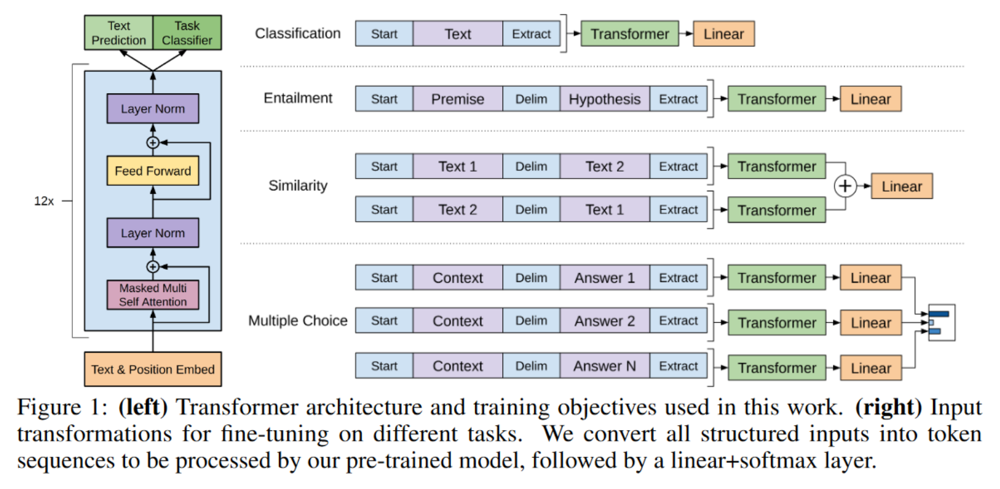

# GPT-2

- 1.5B parameters (10xGPT)
- training - new dataset "WebText" (1M of web-pages, 45M of links, 8M documents, links from Reddit with carma >= 3, don't use Wiki)
- text preprocessing (lower-case, tokenization, use out-of-vocabulary tokens, Unicode -> UTF-8)
- use BPE, but tokens are sequence of bytes, not symbols; also don't merge symbols of different type (like "dog" and "?")
- move layer norm after self-attention block
- different initialization
- vocabulary = 50K
- context size = 1024
- batch size = 512
- d = 1600
- SOTA in 7 tasks of 8 (zero-shot setting - no fine-tuning to task)
- up to 48 layers
- Multitask Learning as Question Answering (MQAN) (if queistion begins from "translate" - model should continue text with translation, if it begins from "answer the question" - model should continue text with question answering, etc.)
- MQAN lets task solving without supervised fine-tuning on specialized data!

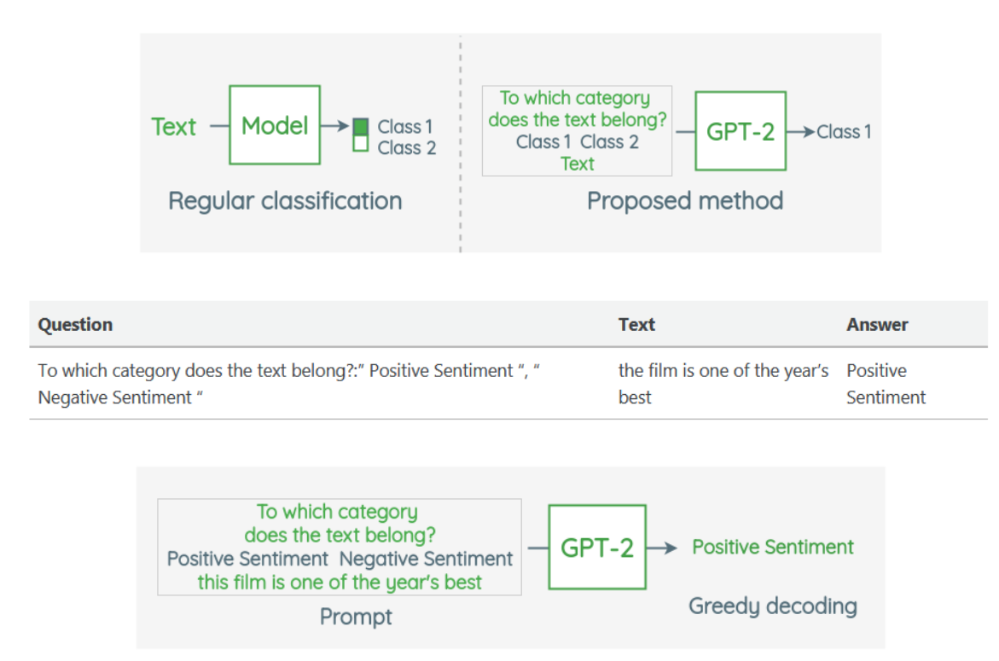

# GPT-3

- same architechture as GPT-2
- 96 layers / 96 heads
- d = 12888
- context window size = 2048
- 175B parameters (100xGPT-2)
- alternating dense and locally banded sparse attention patterns
- more data in training set
- no fine-tuning to any specific task
- can solve "on-the-fly" tasks - tasks which it wasn't trained for
- datasets:

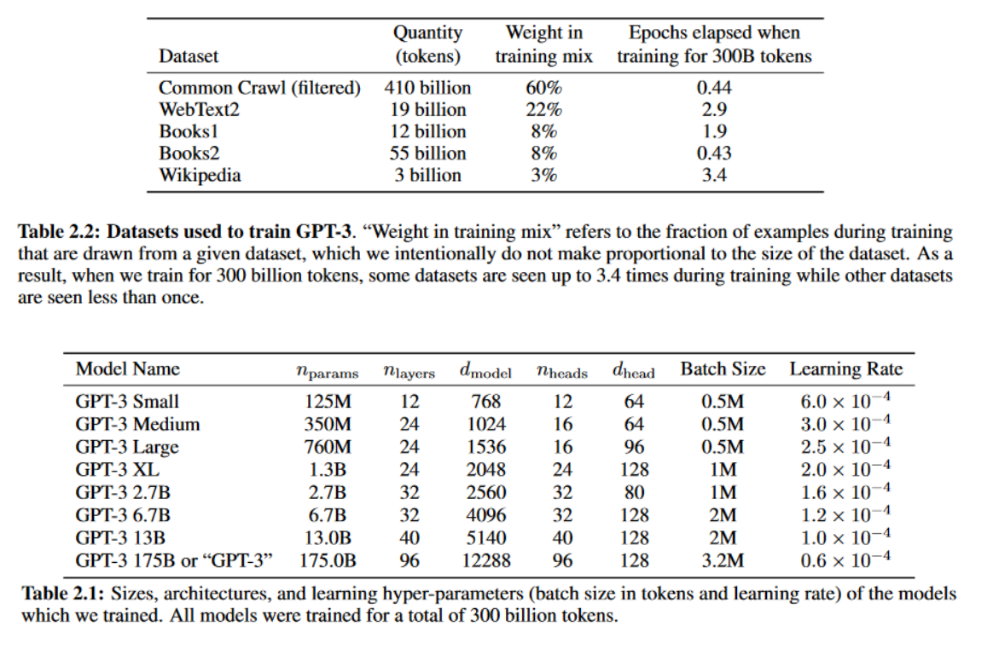

### Zero-shot vs one-shot vs few-shot vs fine-tuning

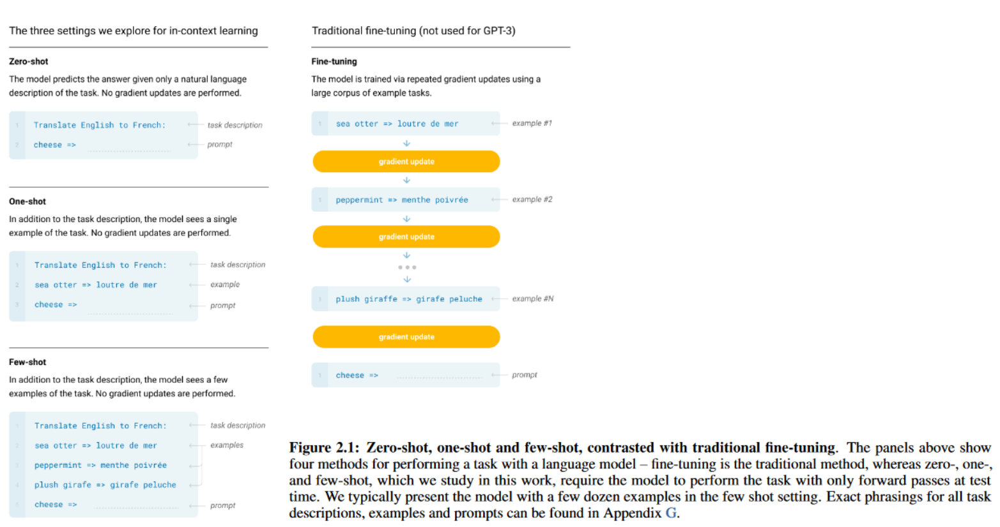

More info here https://arxiv.org/abs/2005.14165

# Language models benchmark

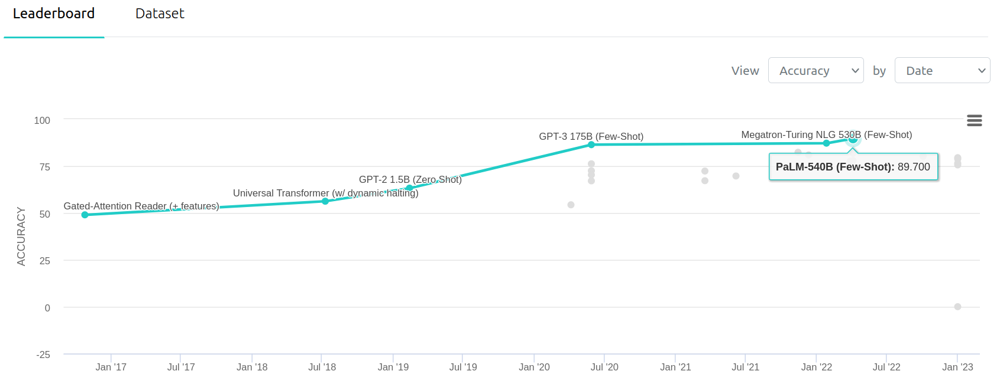

# Text generation/degeneration

Task: open-ended text generation with context x<sub>1</sub>, x<sub>2</sub>, ... x<sub>m</sub>, m < T

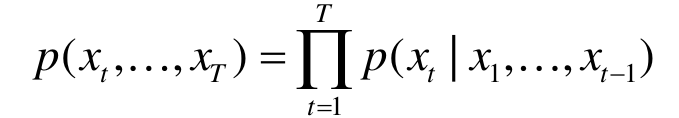

I.e. we need to continue the text. We have the next word probability distribution from our model. How to select the next word?

### Greedy decoding / beam search

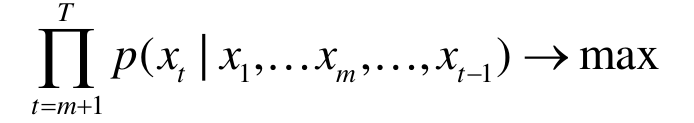

Select the most probable word or select among set of the most probable words. This strategy fails, it leads to the text cycling and unnaturalness (text degeneration). Transformer architechture also leads to text repeation (next word occurs among previous 128 words in 63% of cases, in human speech - in 49% of cases)

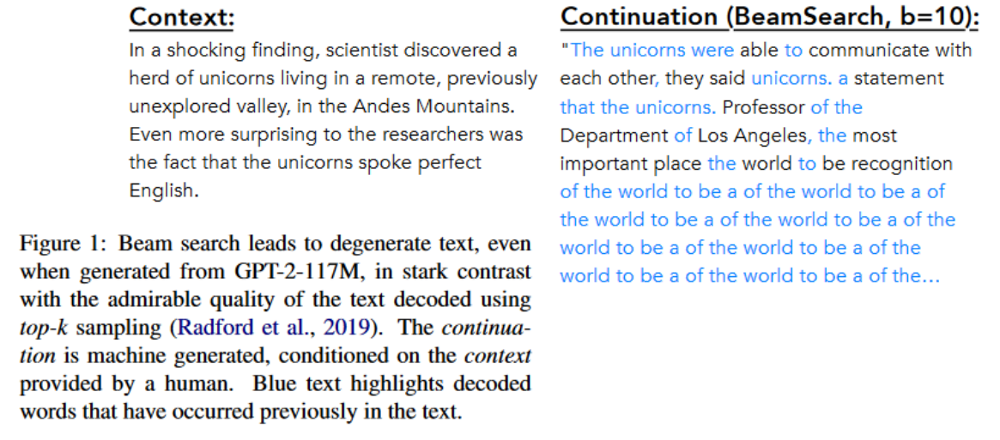

### Wide/narrow distribution problem

How to select words from narrow (couple of words are the most probable) and wide distribution (a lot of words has similar probability)?

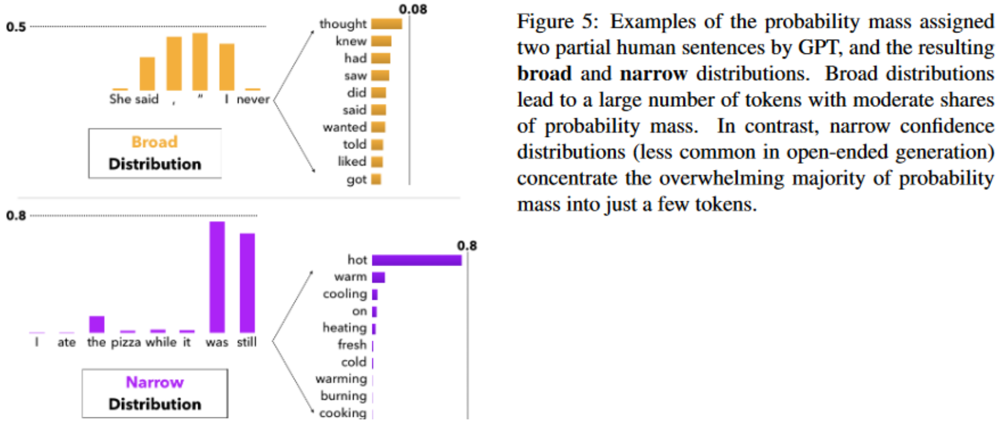

### How to tackle with text degeneration?

- sampling with temperature; select words according to their probability and also add temperature parameter, which may increase/decrease word's probability

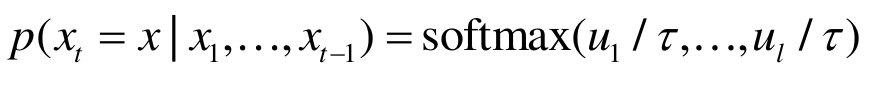

- top-k sampling; select among top k most probable words 

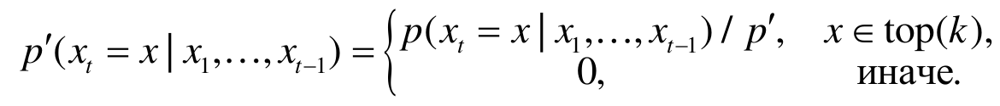

- nucleus (top-p) sampling; select among most probable words whose total probability sum more than some parameter value (p)

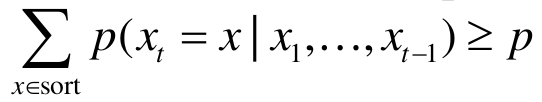

- penalized sampling; penalizes words that are in already met in the context of previous words (way to tackle with word repeation)

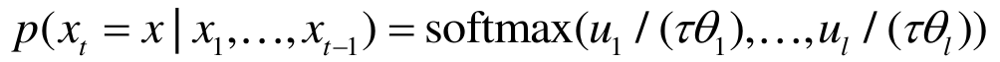

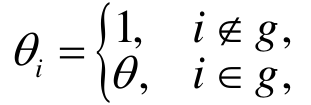

Nucleus Sampling looks the most adequate

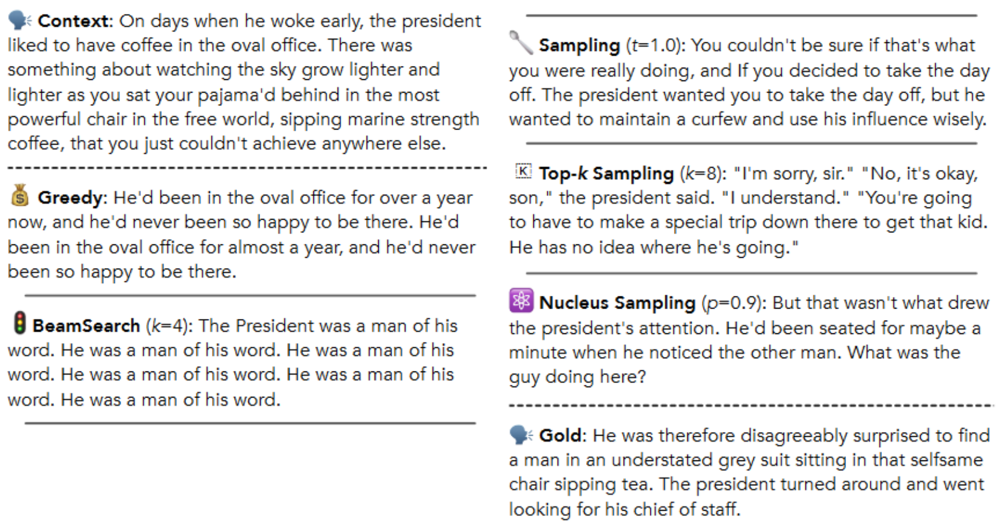

# What to read next

- Natural Language Processing with Deep Learning http://web.stanford.edu/class/cs224n/
- Deconding Strategies Review https://lilianweng.github.io/lil-log/2021/01/02/controllable-neural-text-generation.html